In [1]:
import numpy as np
import matplotlib.pyplot as plt

# 1. Préliminaires

In [47]:
def f_1(X, alpha=1):
    return alpha * np.sum(X**2)

def f_2(X, alpha=1):
    n = len(X)
    s = 0
    for i in range(1, n+1):
        s += (10**(alpha*(i-1)/(n-1))*X[i-1])**2
    return s/2

def f_3(X, alpha=1):
    n = len(X)
    s = 10*n
    i = 0
    for x in X:
        i += 1
        s += (10**(alpha*(i-1)/(n-1))* (x-1)**2) - 10*np.cos(2*np.pi*(x-1))
    return s

def f_4(X, alpha=1):
    X = np.array(X, dtype=np.float64)
    n = len(X)
    s = 0
    for i in range(0,n-1):
        s += 10**alpha * ((X[i]-1)**2 - (X[i+1]-1))**2 + (X[i] - 2)**2    
    return s

In [36]:
def evaluate(f, a, x_min=-10, x_max=10, y_min=-10, y_max=10):
    x = np.linspace(x_min, x_max, 50) 
    y = np.linspace(y_min, y_max, 50)
    X, Y = np.meshgrid(x, y)

    Z = []        
    for i in range(len(X)):
        l = []
        for j in range(len(Y)):
            l += [f(np.array([X[i,j], Y[i,j]]), a)]
        Z += [l]
        
    return X, Y, Z

f_1


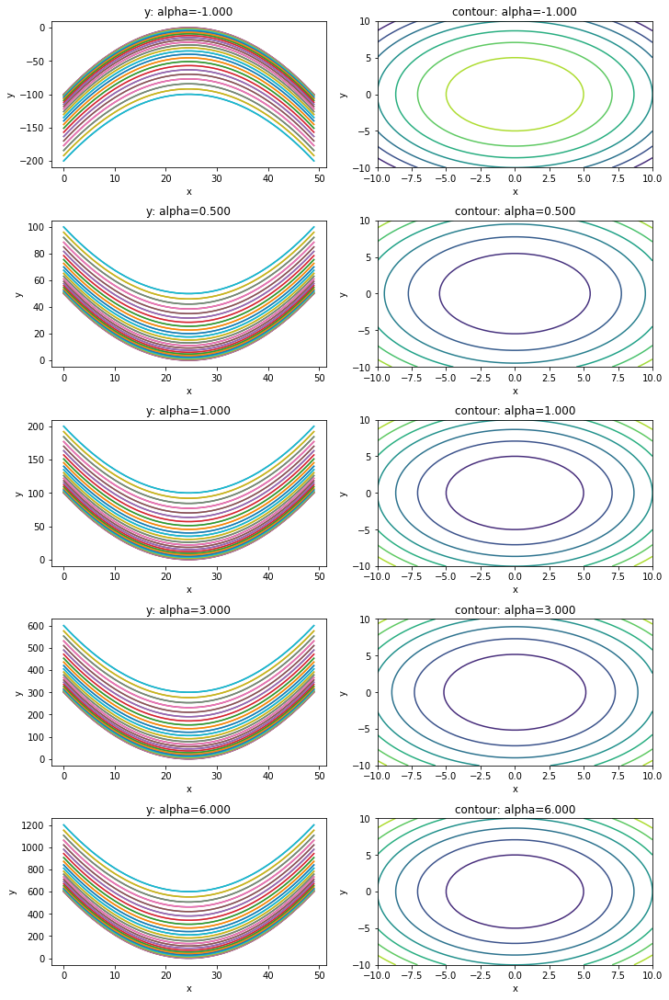

f_2


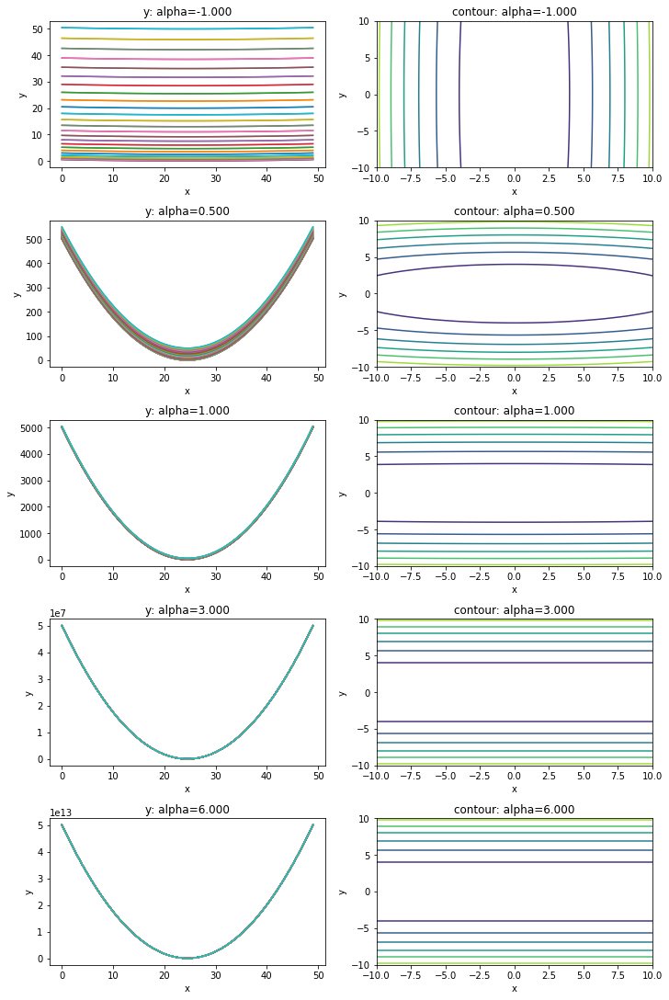

f_3


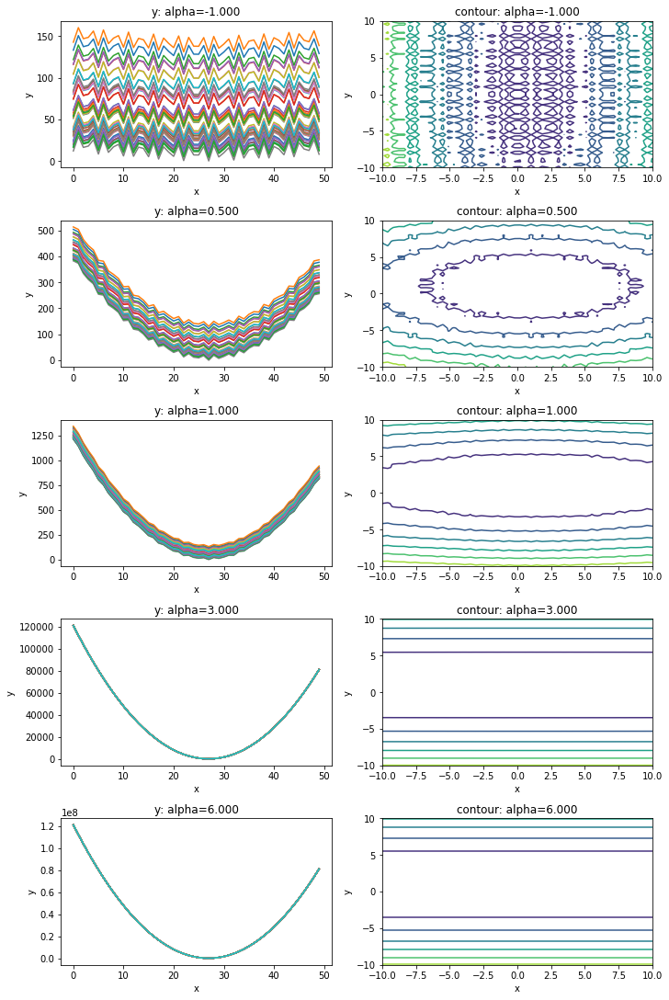

f_4


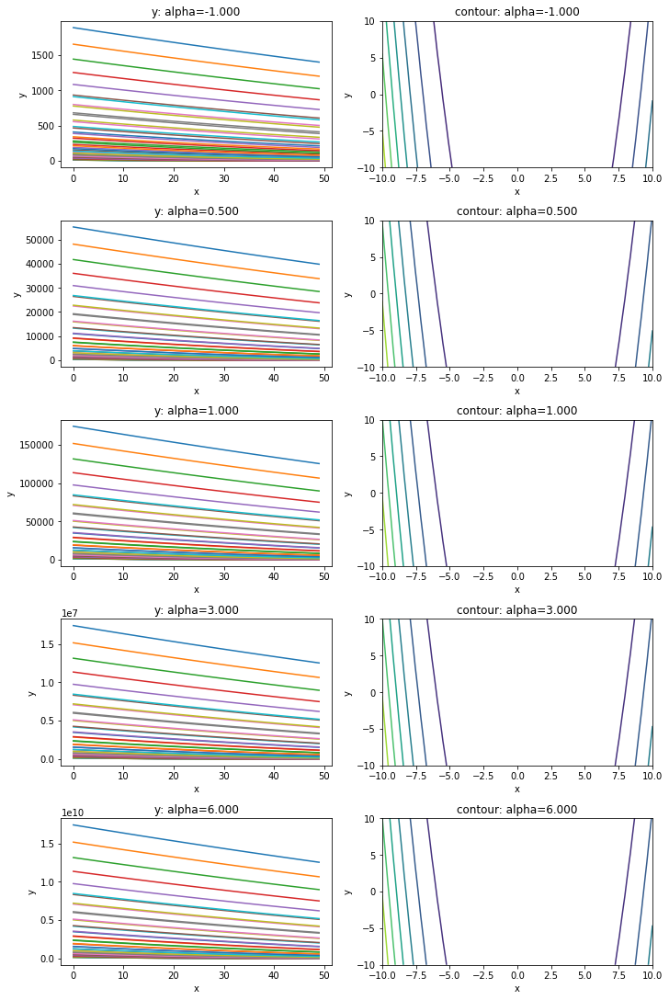

In [4]:
dir_path = './imgs/contours/'

alpha = [-1, 1/2, 1, 3, 6]

x = np.linspace(-2, 2, 50) 
y = np.linspace(-2, 2, 50)
X, Y = np.meshgrid(x, y)

functions = [f_1, f_2, f_3, f_4]
for f in functions:
    
    # plots ys
    fig, axs = plt.subplots(len(alpha), 2, figsize=(10,15), constrained_layout=True)
    for row_i, a in enumerate(alpha):
        
        X, Y, Z = evaluate(f, a)

        # plot
        axs[row_i, 0].plot(Z)
        axs[row_i, 0].set_title('y: alpha=%.3f' % a)
        axs[row_i, 0].set_xlabel('x')
        axs[row_i, 0].set_ylabel('y')
        axs[row_i, 1].contour(X, Y, Z)
        axs[row_i, 1].set_title('contour: alpha=%.3f' % a)
        axs[row_i, 1].set_xlabel('x')
        axs[row_i, 1].set_ylabel('y')
        row_i += 1

    plt.savefig(dir_path + f.__name__)
    print(f.__name__)
    plt.show()

f_1


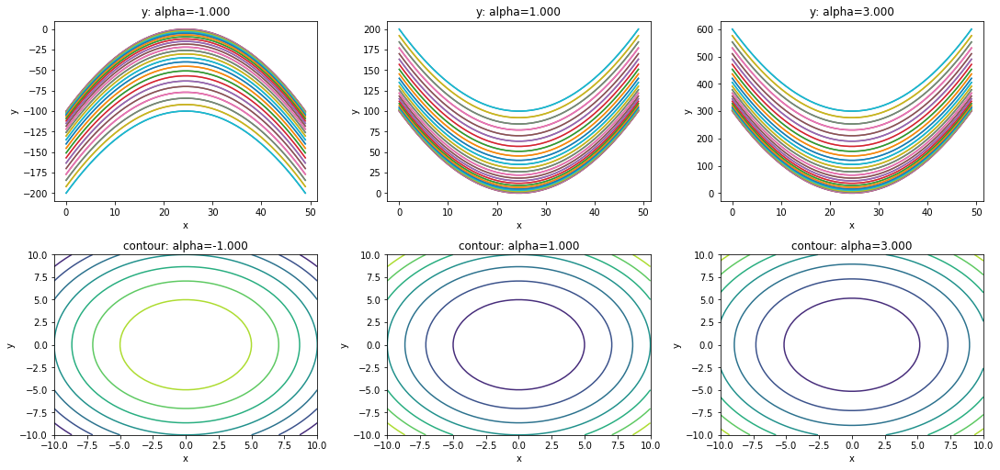

f_2


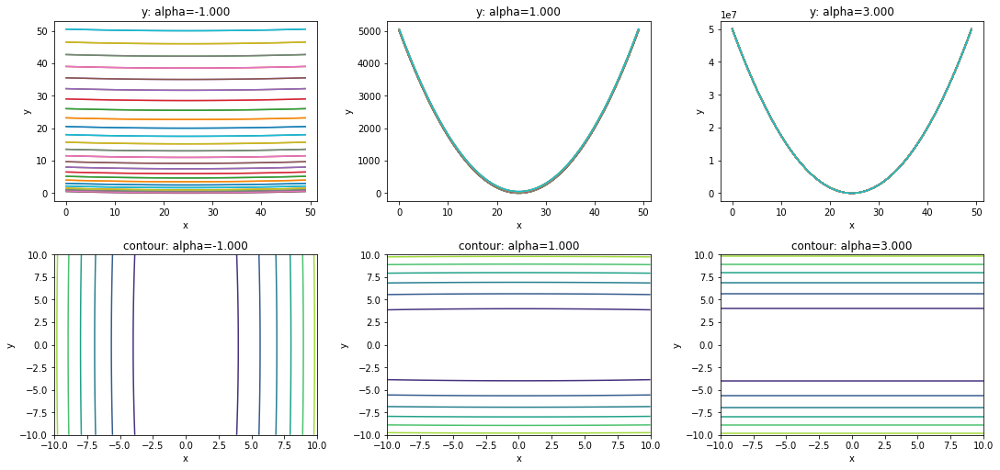

f_3


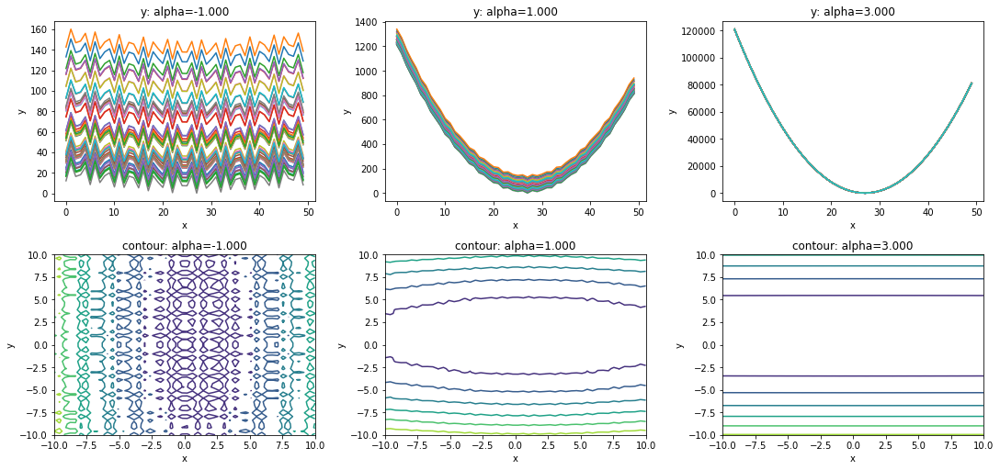

f_4


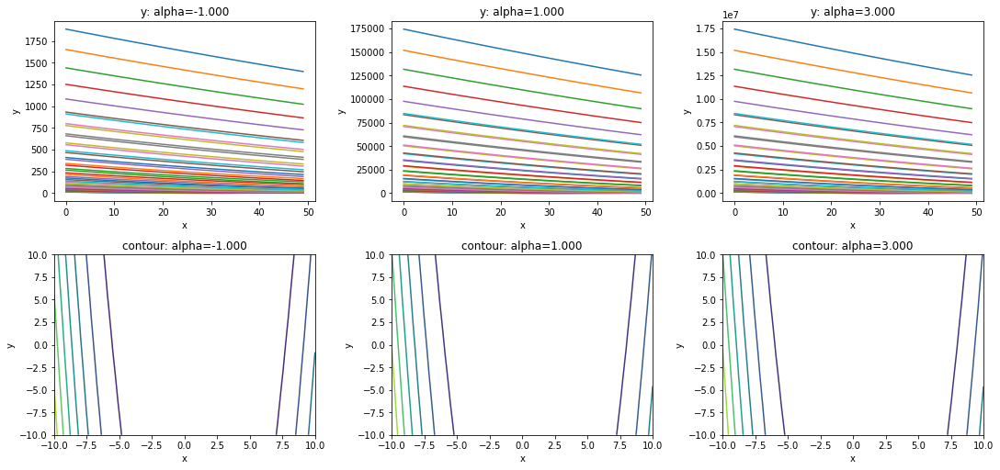

In [5]:
dir_path = './imgs/contours/'

alpha = [-1, 1, 3,]

x = np.linspace(-2, 2, 50) 
y = np.linspace(-2, 2, 50)
X, Y = np.meshgrid(x, y)

functions = [f_1, f_2, f_3, f_4]
for f in functions:
    
    # plots ys
    fig, axs = plt.subplots(2, 3, figsize=(15,7), constrained_layout=True)
    for col_i, a in enumerate(alpha):
        
        X, Y, Z = evaluate(f, a)

        # plot
        axs[0, col_i].plot(Z)
        axs[0, col_i].set_title('y: alpha=%.3f' % a)
        axs[0, col_i].set_xlabel('x')
        axs[0, col_i].set_ylabel('y')
        
        axs[1, col_i].contour(X, Y, Z)
        axs[1, col_i].set_title('contour: alpha=%.3f' % a)
        axs[1, col_i].set_xlabel('x')
        axs[1, col_i].set_ylabel('y')
        col_i += 1

    plt.savefig(dir_path + f.__name__ + "_texpres")
    print(f.__name__)
    plt.show()

# 2. Gradient Descent

In [48]:
def f_1_prime(X, alpha=1):
    return 2 * alpha * X

def f_2_prime(X, alpha=1):
    n = len(X)
    s = []
    for i in range(1, n+1):
        s += [(10**(alpha*(i-1)/(n-1))*X[i-1])]
    return np.array(s)

def f_3_prime(X, alpha=1):
    n = len(X)
    s = []
    i = 0
    for x in X:
        i += 1
        s += [(10**(alpha*(i-1)/(n-1))*2*(x-1) + 10*2*np.pi*np.sin(2*np.pi*(x-1)))]
    return np.array(s)

def f_4_prime(X, alpha=1):
    X = np.array(X, dtype=np.float64)

    n = len(X)
    s = []
    
    # 1
    g = 4*10**alpha * (X[0]-1)*((X[0] - 1)**2 - (X[1] - 1)) + 2*(X[0] - 2)
    s += [g]
    
    # 2 ... n-1
    for i in range(1,n-1):
        g = 4*10**alpha * (X[i]-1)*((X[i] - 1)**2 - (X[i+1] - 1)) + 2*(X[i] - 2)
        g += -2*10**alpha*((X[i]-1)**2 - (X[i+1] - 1))
        s += [g]
    
    # n
    g = -2*10**alpha*((X[n-2]-1)**2 - (X[n-1] - 1))
    s += [g]
    
    return np.array(s)

def f_4_prime_V2(X, alpha=1):
    x = np.array(X)
    n = len(x)
    x_res = [4*10**a*(x[0]-1)*((x[0] - 1)**2 - (x[1]-1)) + 2*(x[0] - 2)]
    for i in range(2,n):
        x_res.append(4*10**a*(x[i-1]-1)*((x[i-1] - 1)**2 - (x[i]-1)) + 2*(x[i-1] - 2) - 2*10**a*((x[i-2] - 1)**2 - (x[i-1] -1)))
    x_res.append(- 2*10**a*((x[n-2] - 1)**2 - (x[n-1] -1)))
    return np.array(x_res)

## 2.1 Fixed step size

In [7]:
def gd_fixed_sz(X_0, f, f_prime, alpha, sz):
    X = X_0
    tmp_X = X_0
    
    ys = []
    xs = []
    
    for i in range(10**5):
        d = f_prime(X, alpha)
                
        tmp_X = tmp_X - sz*d
        
        y1 = f(X, alpha)
        y2 = f(tmp_X, alpha)
        
        if y2 < y1:
            ys += [y2]
            X = tmp_X
        else:
            ys += [y1]
            
        xs += [X]
    
        if np.linalg.norm(d) < 1e-12:
            #print('i: ', i, ', d:', np.abs(d), ' break !')
            break
        
    return np.array(xs), np.array(ys)

f_1 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1e-05
f_1 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.001
f_1 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.01
f_1 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1
f_1 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  2


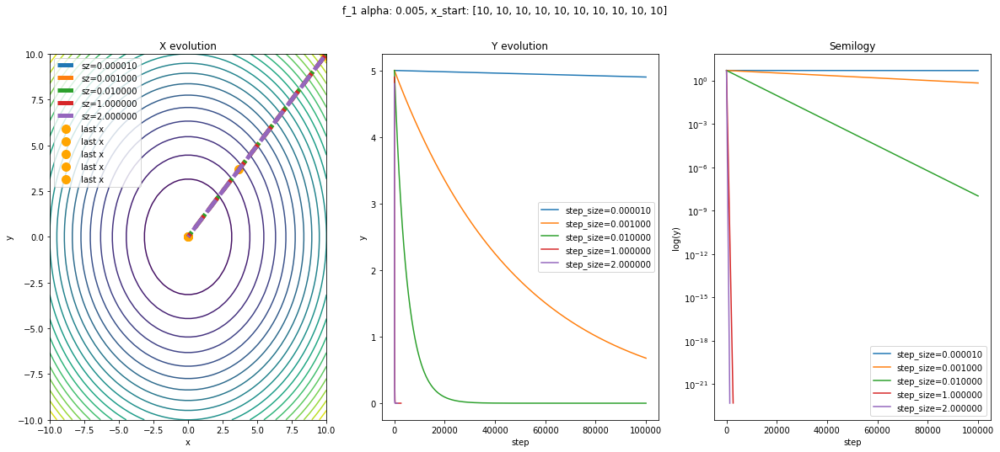

f_1 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1e-05
f_1 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.001
f_1 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.01
f_1 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1
f_1 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  2


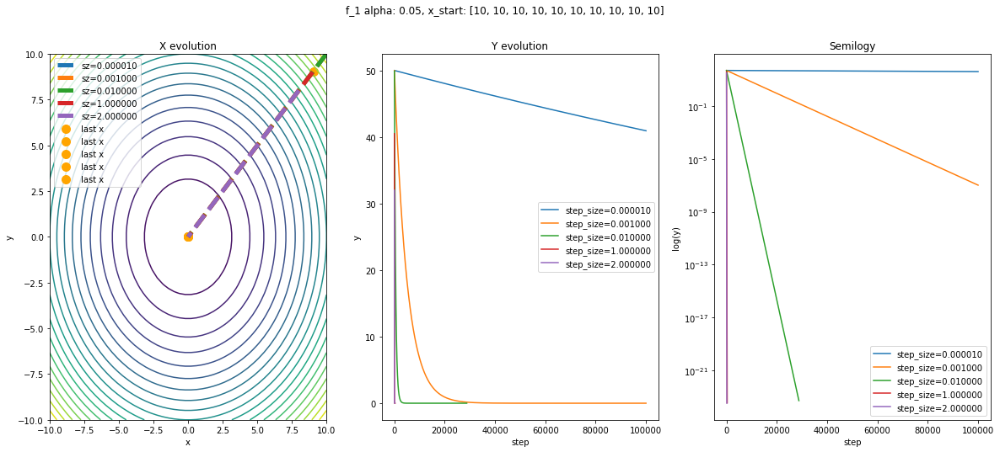

f_1 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1e-05
f_1 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.001
f_1 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.01
f_1 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1
f_1 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  2


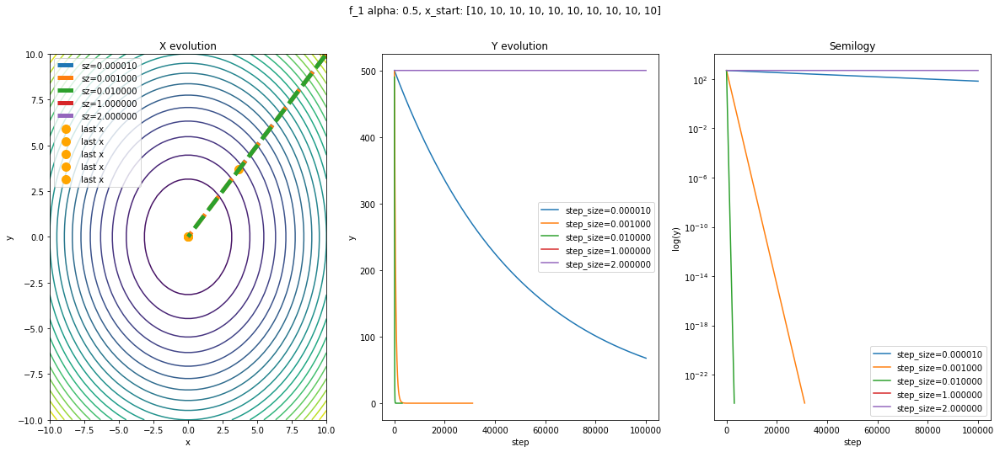

f_1 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1e-05
f_1 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.001
f_1 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.01
f_1 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1
f_1 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  2


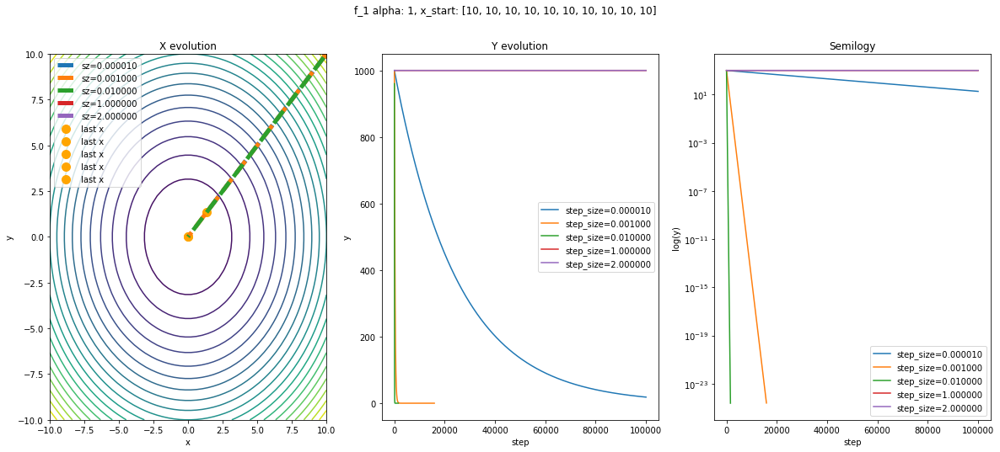

f_1 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1e-05
f_1 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.001
f_1 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.01
f_1 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1
f_1 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  2


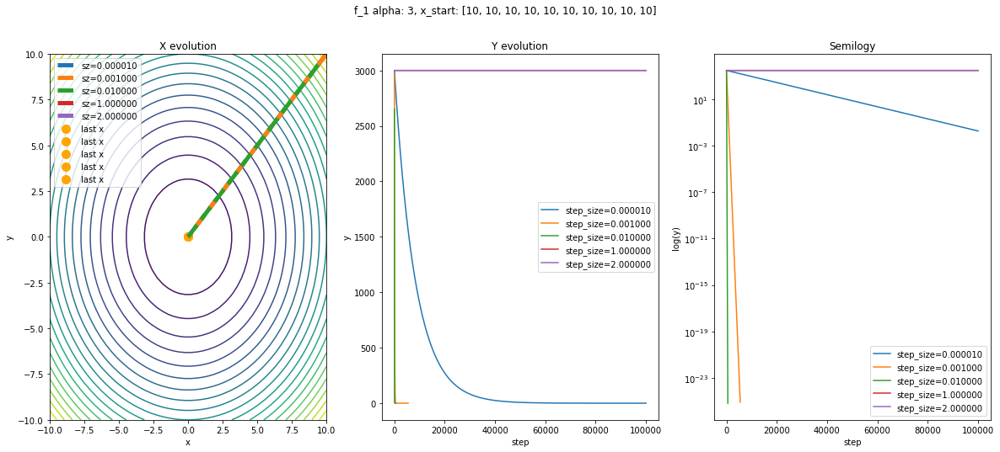

f_2 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1e-05
f_2 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.001
f_2 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.01
f_2 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1
f_2 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  2


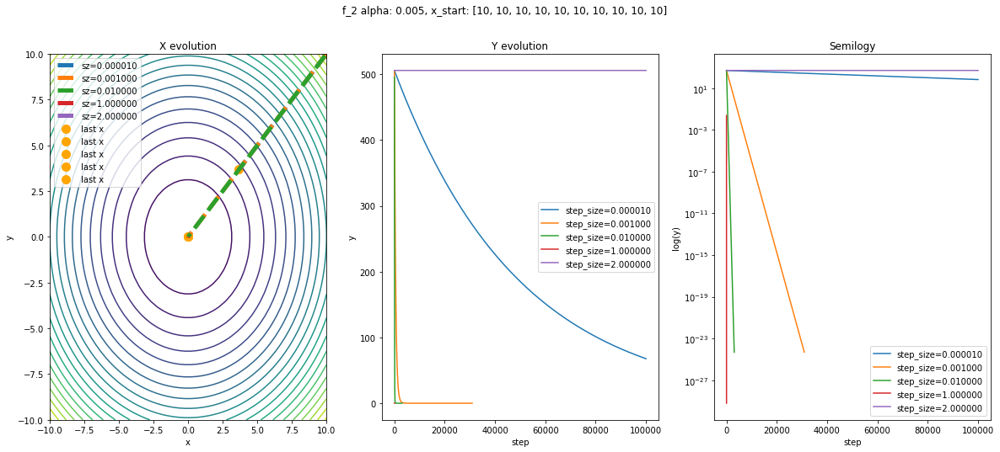

f_2 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1e-05
f_2 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.001
f_2 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.01
f_2 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1
f_2 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  2


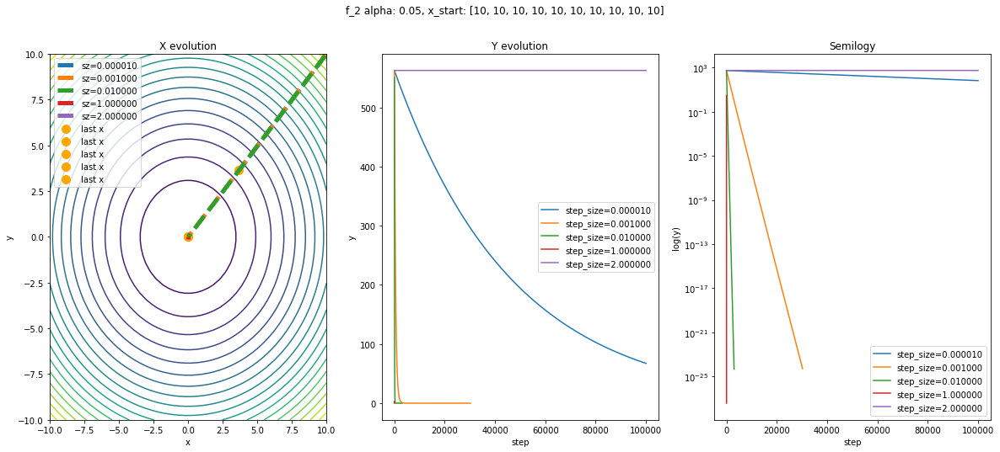

f_2 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1e-05
f_2 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.001
f_2 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.01
f_2 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1
f_2 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  2


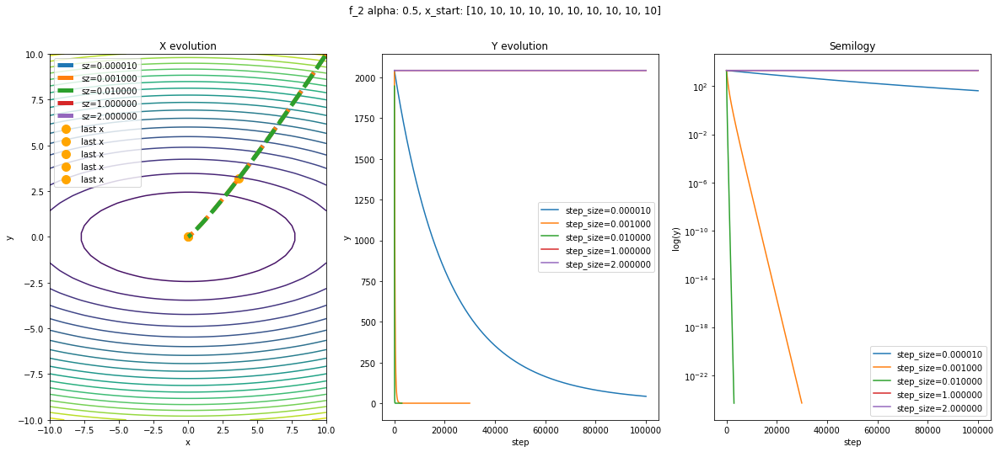

f_2 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1e-05
f_2 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.001
f_2 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.01
f_2 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1
f_2 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  2


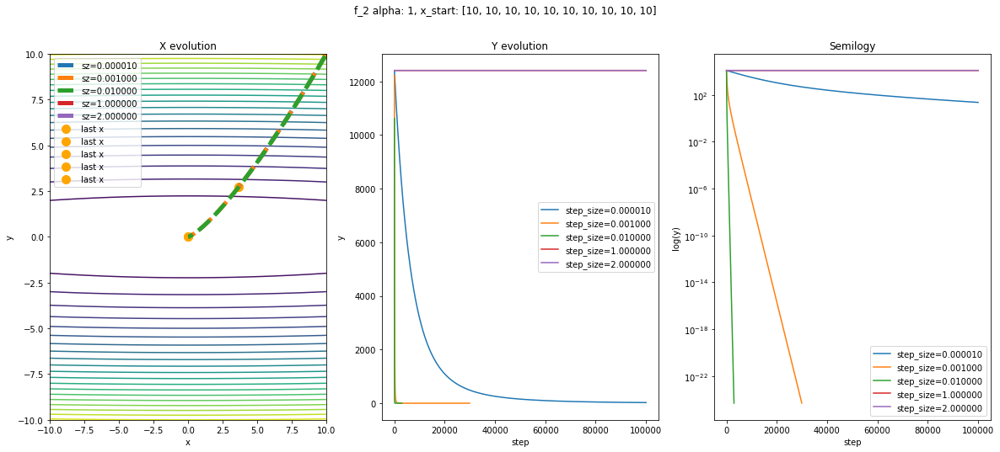

f_2 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1e-05
f_2 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.001
f_2 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.01
f_2 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1
f_2 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  2


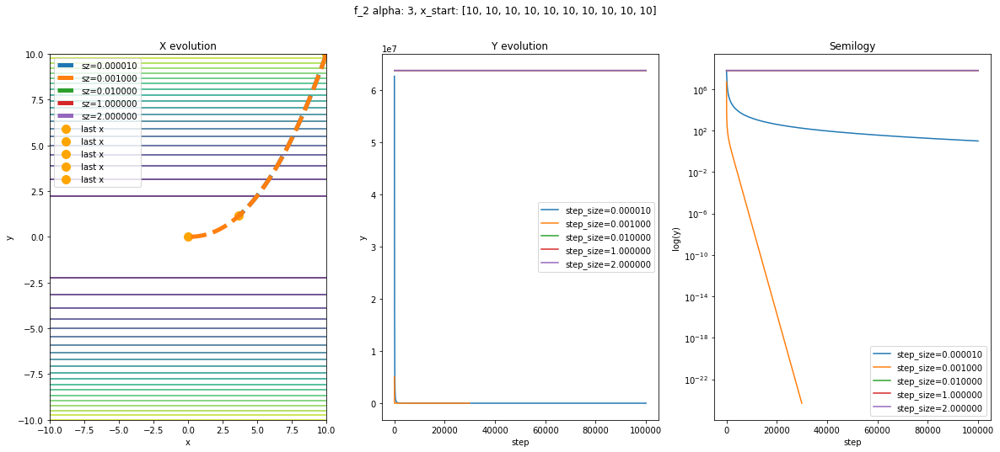

f_3 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1e-05
f_3 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.001
f_3 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.01
f_3 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1
f_3 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  2


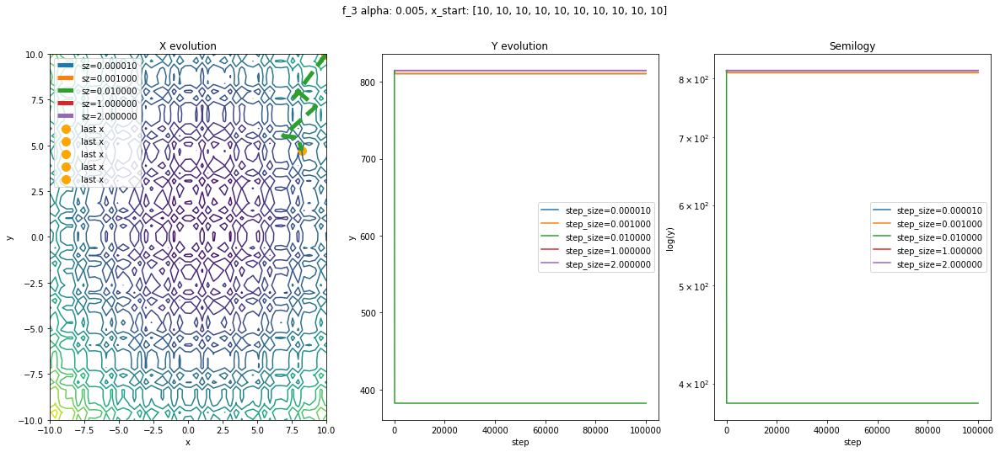

f_3 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1e-05
f_3 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.001
f_3 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.01
f_3 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1
f_3 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  2


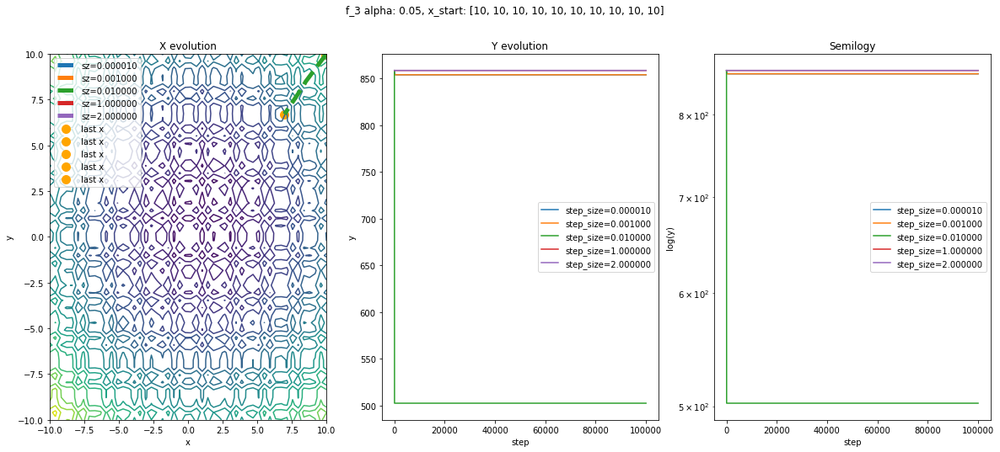

f_3 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1e-05
f_3 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.001
f_3 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.01
f_3 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1
f_3 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  2


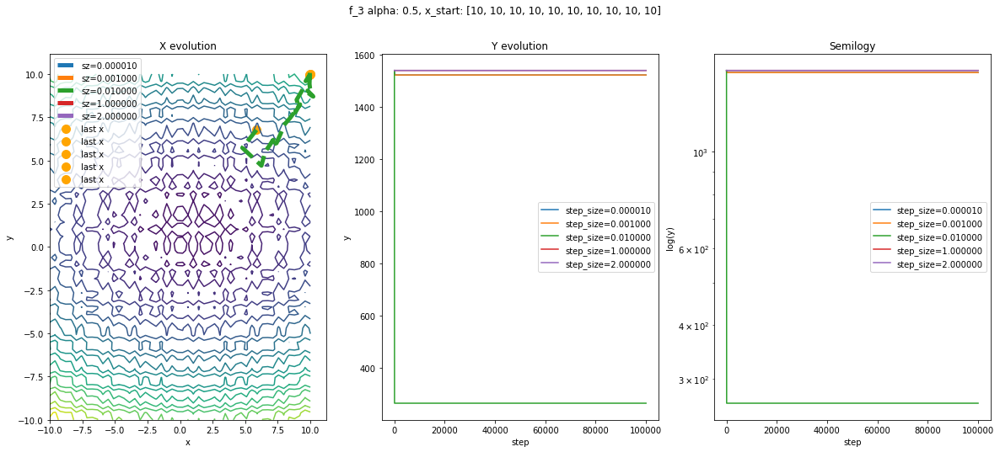

f_3 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1e-05
f_3 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.001
f_3 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.01
f_3 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1
f_3 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  2


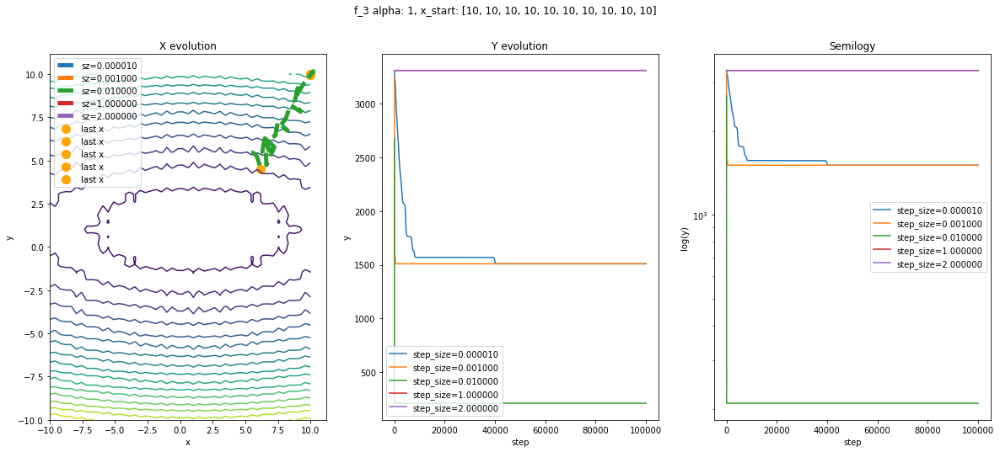

f_3 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1e-05
f_3 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.001
f_3 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.01
f_3 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1
f_3 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  2


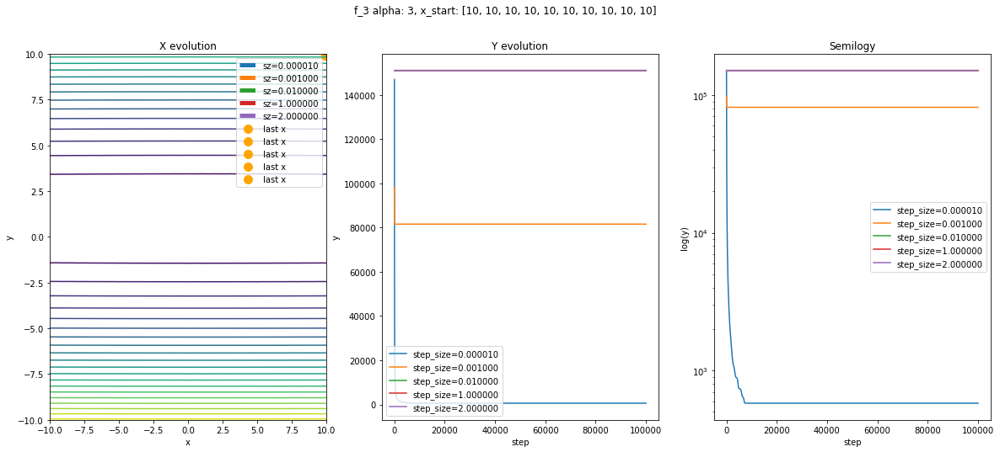

f_4 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1e-05
f_4 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.001
f_4 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.01
f_4 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1
f_4 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  2


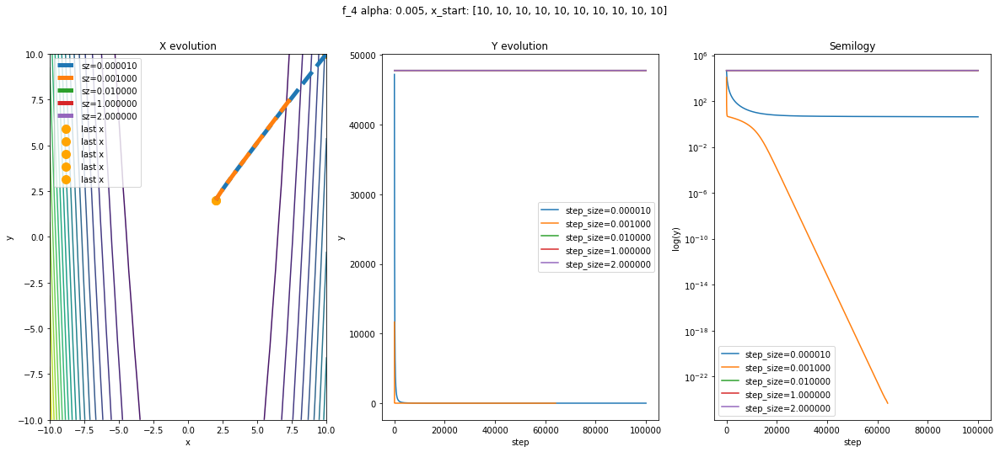

f_4 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1e-05
f_4 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.001
f_4 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.01
f_4 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1
f_4 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  2


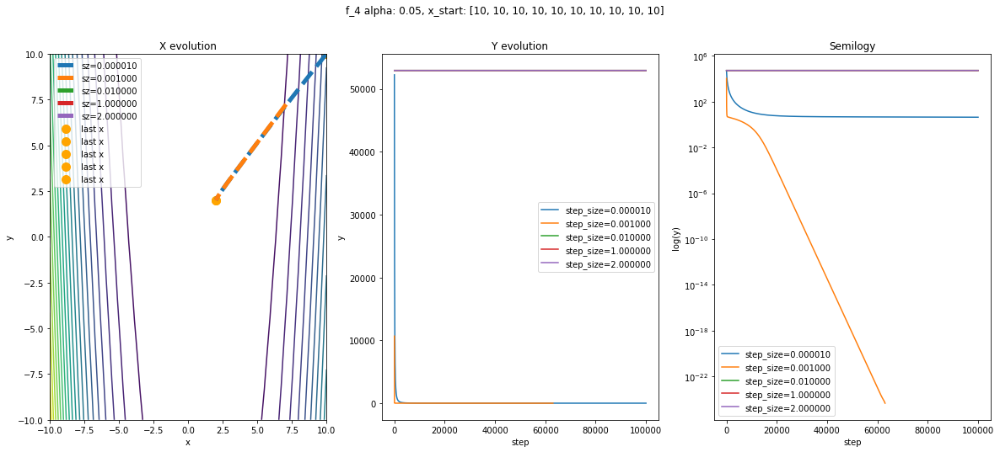

f_4 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1e-05
f_4 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.001
f_4 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.01
f_4 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1
f_4 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  2


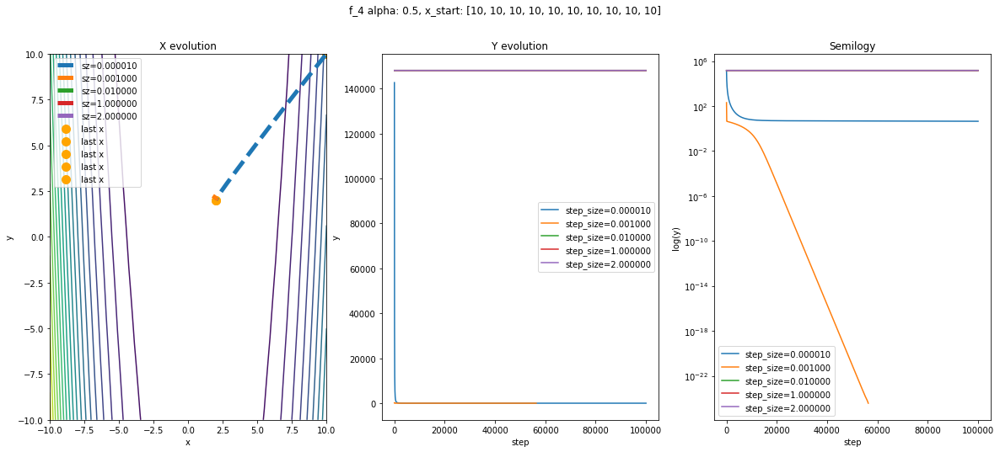

f_4 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1e-05
f_4 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.001
f_4 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.01
f_4 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1
f_4 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  2


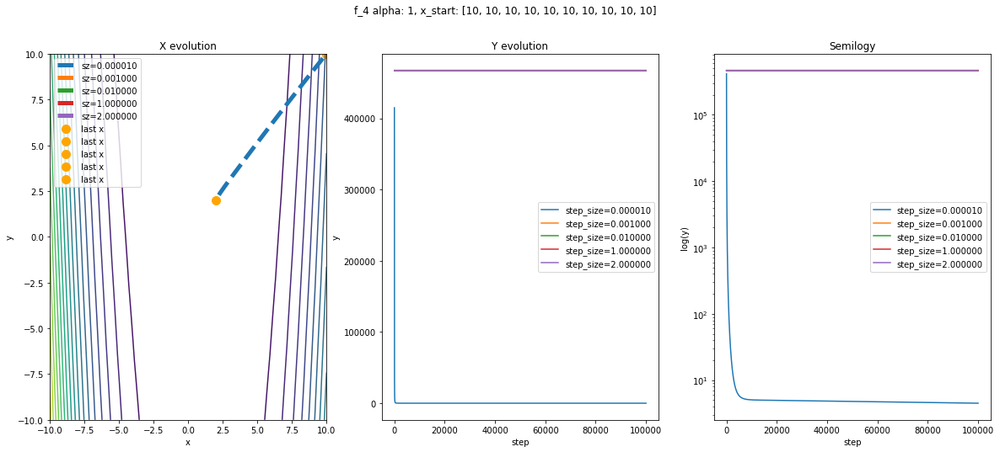

f_4 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1e-05
f_4 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.001
f_4 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  0.01
f_4 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  1
f_4 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10] , setp_size:  2


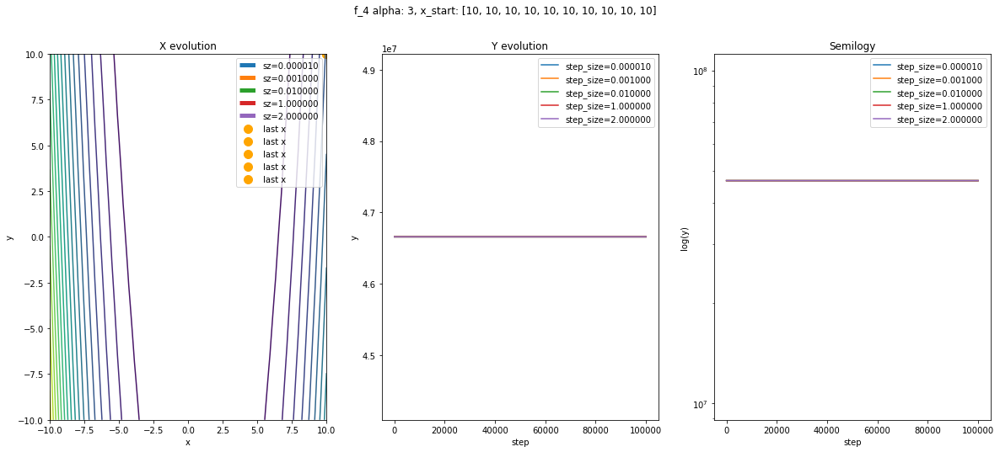

In [8]:
dir_path = './imgs/fixed_sz/'

alpha = [1/200, 1/20, .5, 1, 3]
X_start = [
    [10]*10
]
setp_sizes = [
    1e-5,
    1e-3,
    1e-2,
    1,
    2
]

functions = [f_1, f_2, f_3, f_4]
functions_prime = [f_1_prime, f_2_prime, f_3_prime, f_4_prime]

for f, f_prime in zip(functions, functions_prime):
    for a in alpha:
        for x_i in X_start:
            
            fig, axs = plt.subplots(1, 3, figsize=(20,8))
            fig.suptitle(f.__name__ + ' alpha: ' + str(a) + ', x_start: ' + str(x_i))
            X, Y, Z = evaluate(f, a)
            axs[0].contour(X, Y, Z, 20)

            for sz in setp_sizes:
                print(f.__name__, ': alpha: ', a, ', x_i: ', x_i, ', setp_size: ', sz)

                xs, ys = gd_fixed_sz(np.array(x_i), f, f_prime , a, sz)
                
                axs[0].set_title('X evolution')
                axs[0].set_xlabel('x')
                axs[0].set_ylabel('y')
                axs[0].plot(xs[:,0], xs[:,1], '--', lw=5, label='sz=%f'%sz)
                axs[0].scatter(xs[-1][0], xs[-1][1], c='orange', s=100, label='last x')
                axs[0].legend()
                
                axs[1].set_title('Y evolution')
                axs[1].set_xlabel('step')
                axs[1].set_ylabel('y')
                axs[1].plot(np.arange(len(ys)),ys, label="step_size=%f"%sz)
                axs[1].legend()
                
                axs[2].set_title('Semilogy')
                axs[2].set_xlabel('step')
                axs[2].set_ylabel('log(y)')
                axs[2].semilogy(ys, label="step_size=%f"%sz)
                axs[2].legend()
                
            name = f.__name__ + '_a-' + str(a) + '_fixed_sz' + ".png"
            name = dir_path + name
            plt.savefig(name)
            plt.show()

## 2.2 Step-size Adapatif
### Armijo Rule

In [9]:
def armijo(d, x, f, f_prime, alpha):
    sig = 10
    theta, beta = .5, .5
    
    i = 0
    while True:
        x1 = x + sig*d
        y1 = f(x1, alpha)        
        y2 = f(x, alpha) + theta * sig * np.array(f_prime(x, alpha)).T @ d
        
        if y1 > y2:
            sig = sig*beta
        else:
            #print('i: ', i, ', sig: ', sig, ', armijo break !')
            break
        i += 1
    return sig

In [10]:
def gd_adaptatif_sz(X_0, f, f_prime, alpha):
    X = X_0
    tmp_X = X_0
    
    ys = []
    xs = []
    szs = []
    
    for i in range(10**5):
        d = np.array(f_prime(X, alpha))

        sz = armijo(-d, X, f, f_prime, alpha)
        szs += [sz]
        
        tmp_X = tmp_X - sz*d
        
        y1 = f(X, alpha)
        y2 = f(tmp_X, alpha)
        
        if y2 < y1:
            ys += [y2]
            X = tmp_X
        else:
            ys += [y1]
            
        xs += [X]
    
        if np.linalg.norm(d) < 1e-12:
            #print('i: ', i, ', d:', np.abs(d), ' break !')
            break
        
    return np.array(xs), np.array(ys), np.array(szs)

f_1 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


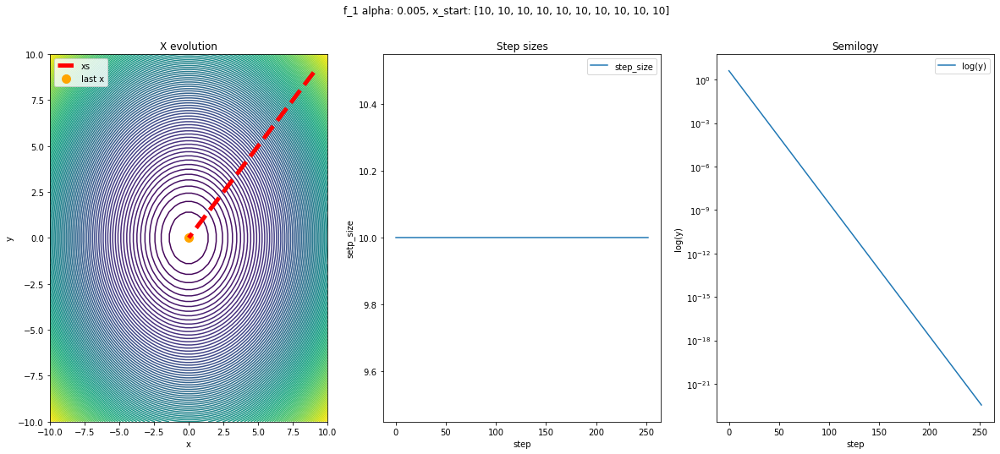

f_1 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


<ipython-input-11-77bf342c63a2>:46: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  plt.savefig(name)


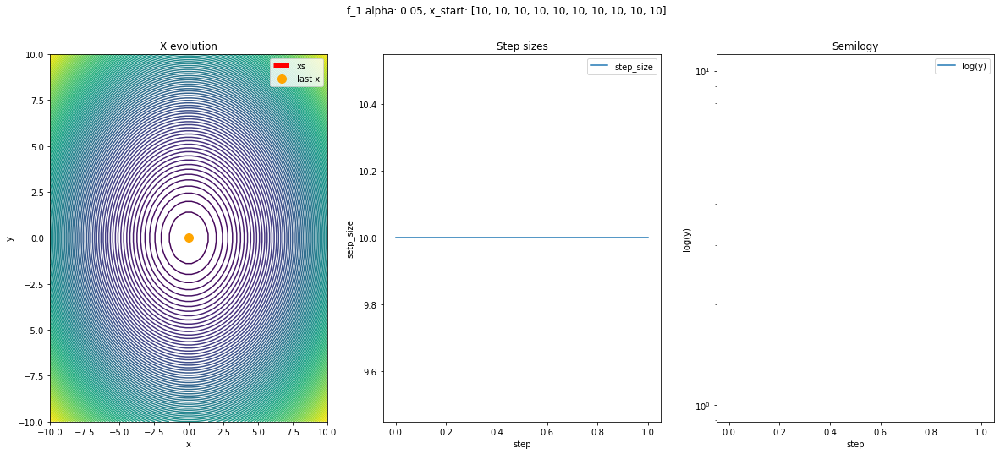

f_1 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


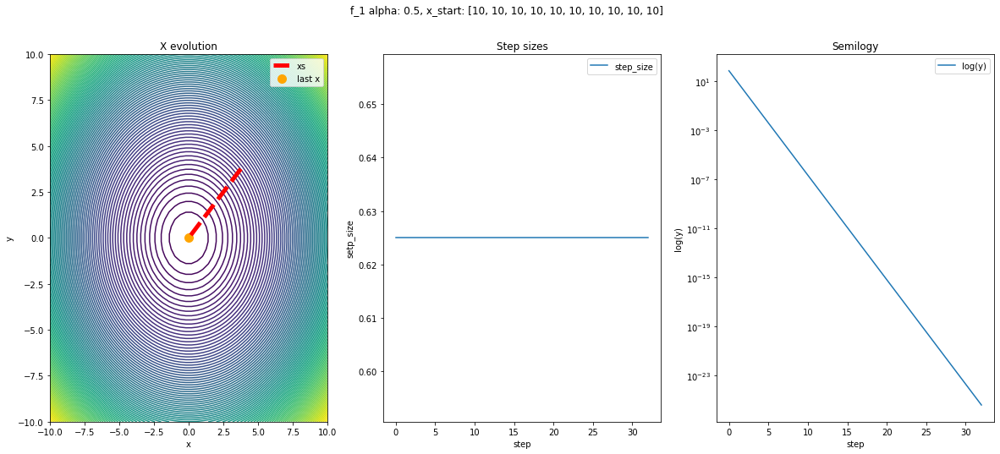

f_1 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


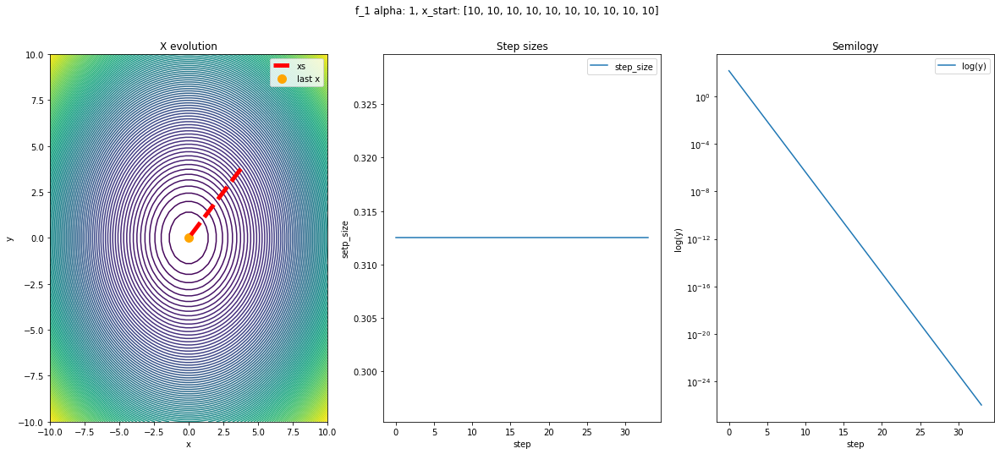

f_1 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


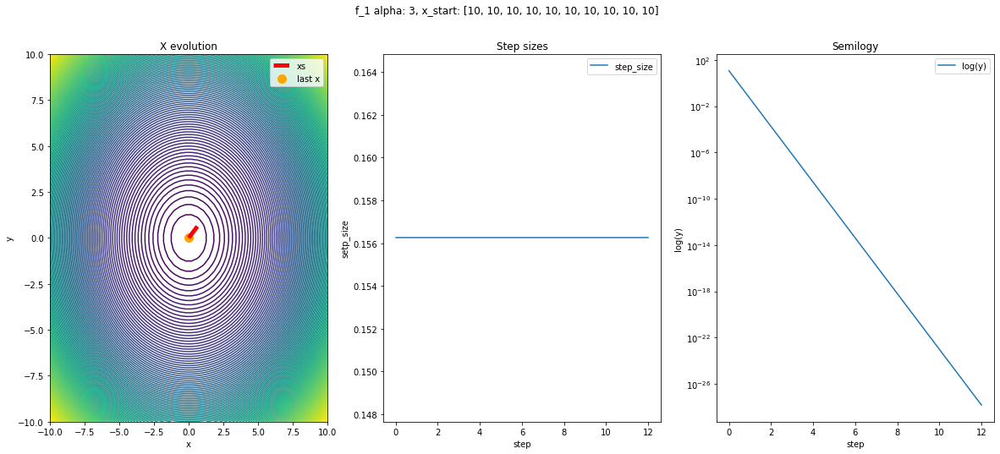

f_2 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


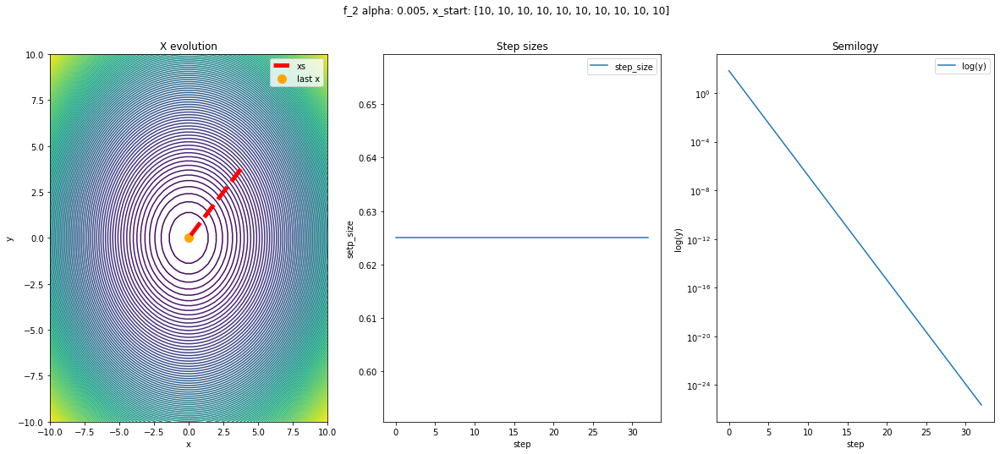

f_2 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


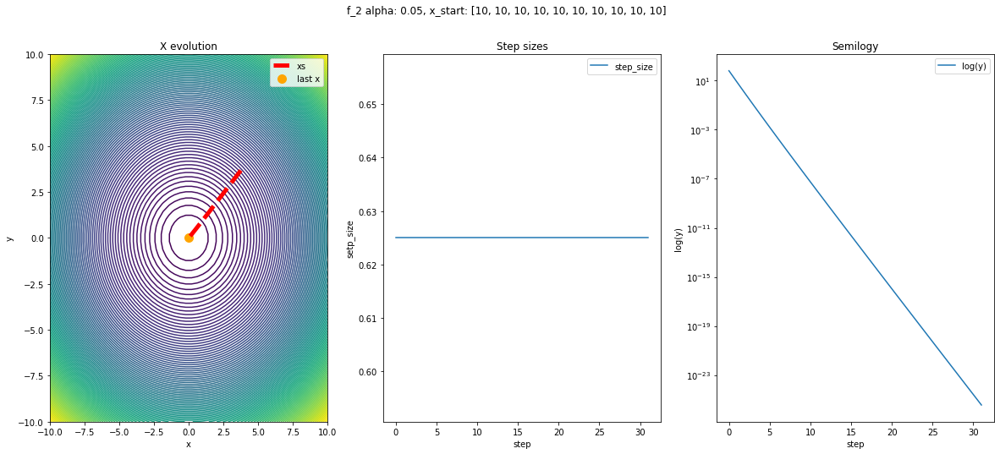

f_2 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


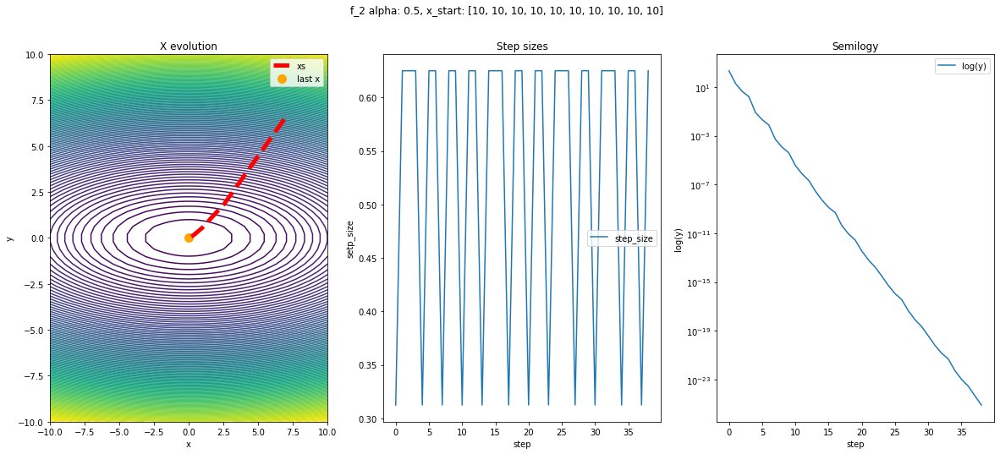

f_2 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


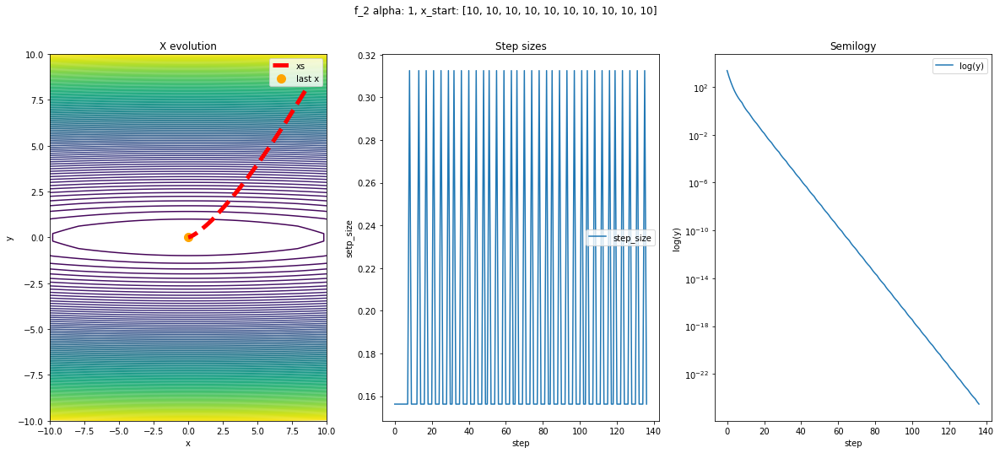

f_2 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


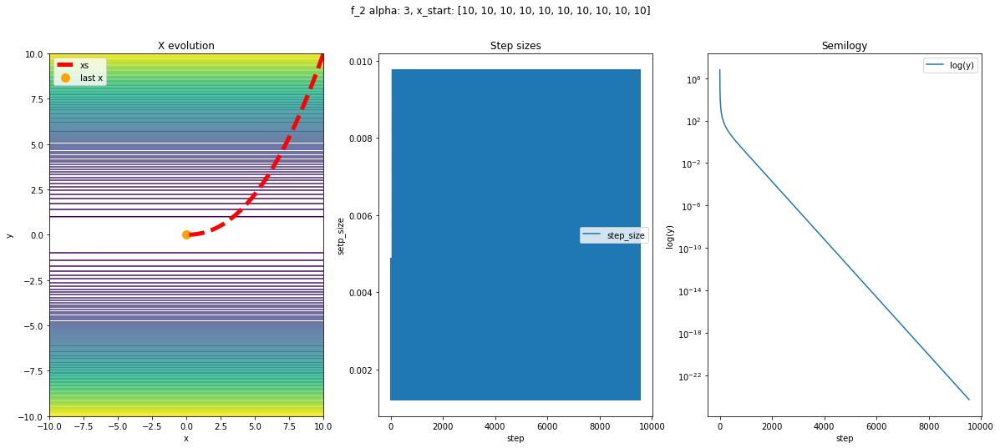

f_3 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


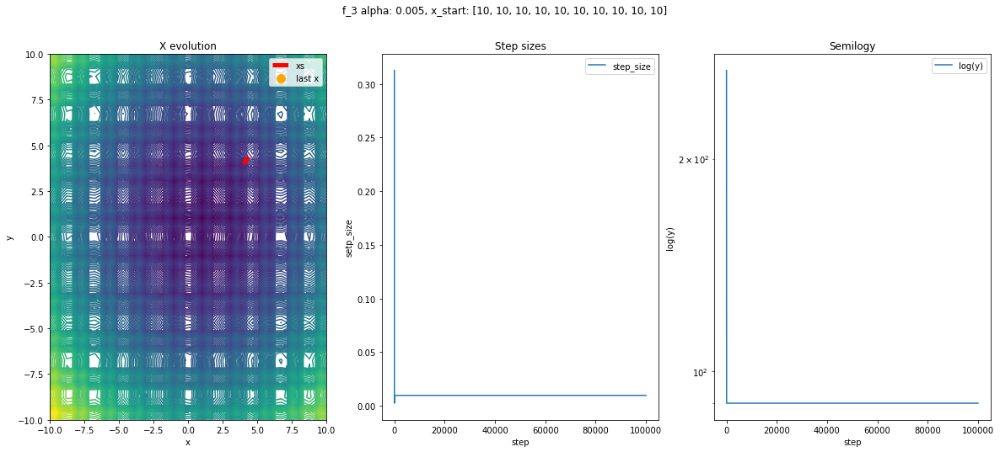

f_3 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


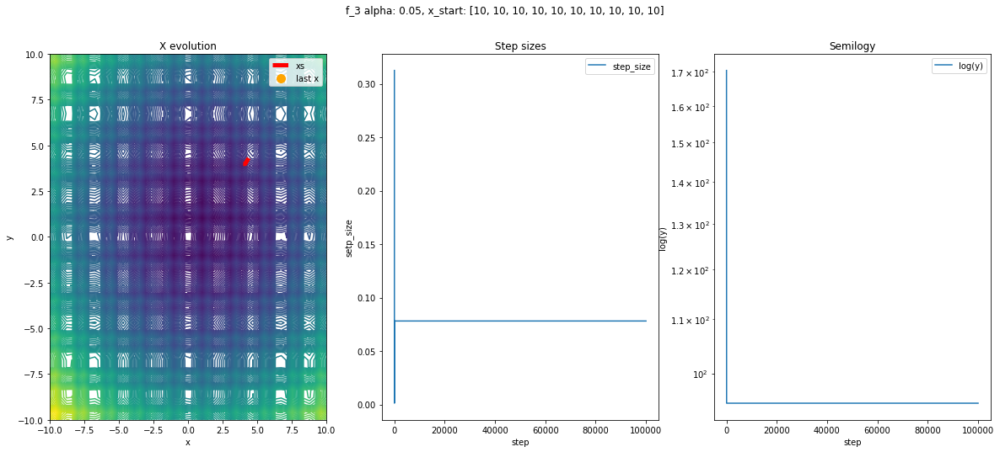

f_3 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


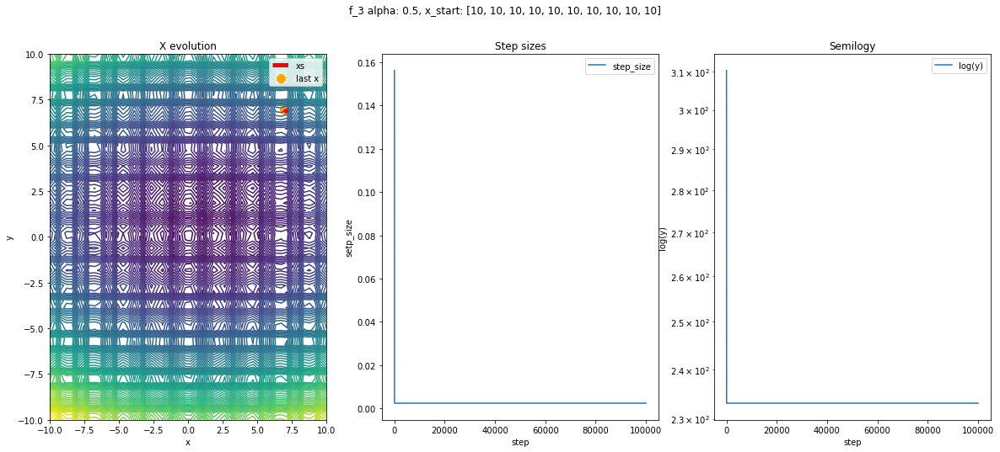

f_3 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


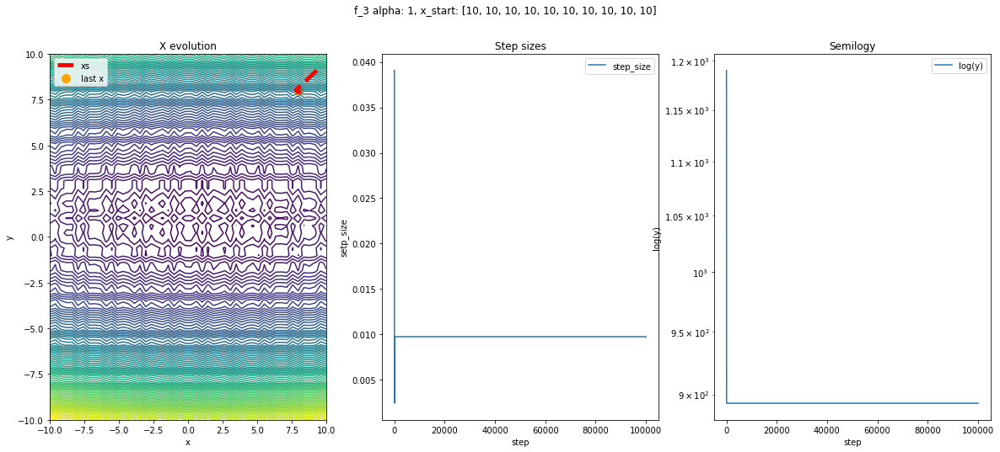

f_3 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


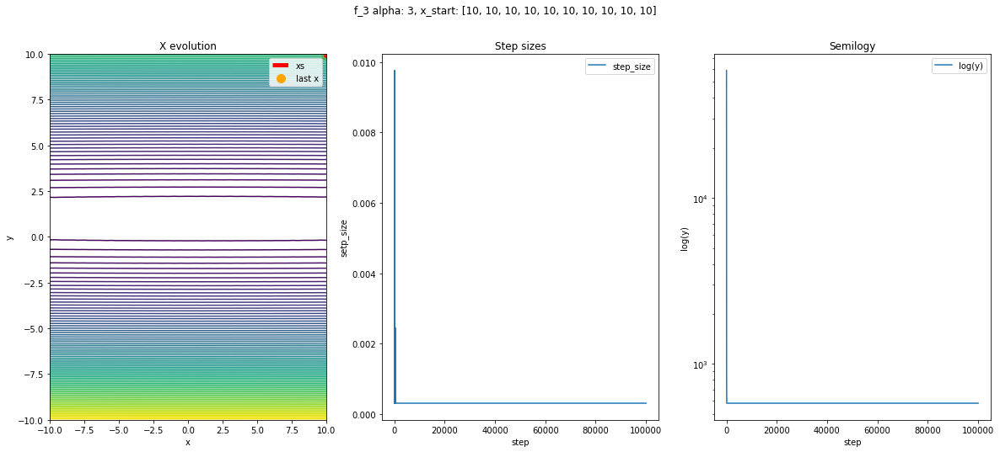

f_4 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


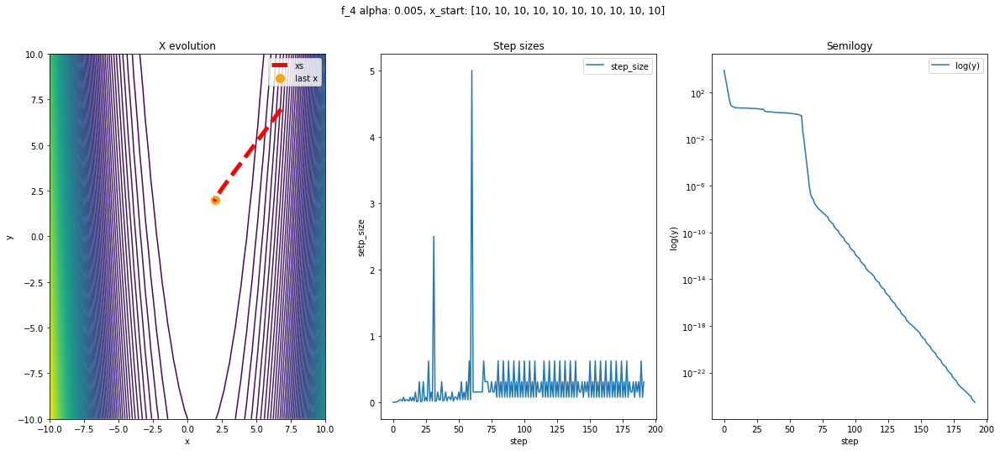

f_4 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


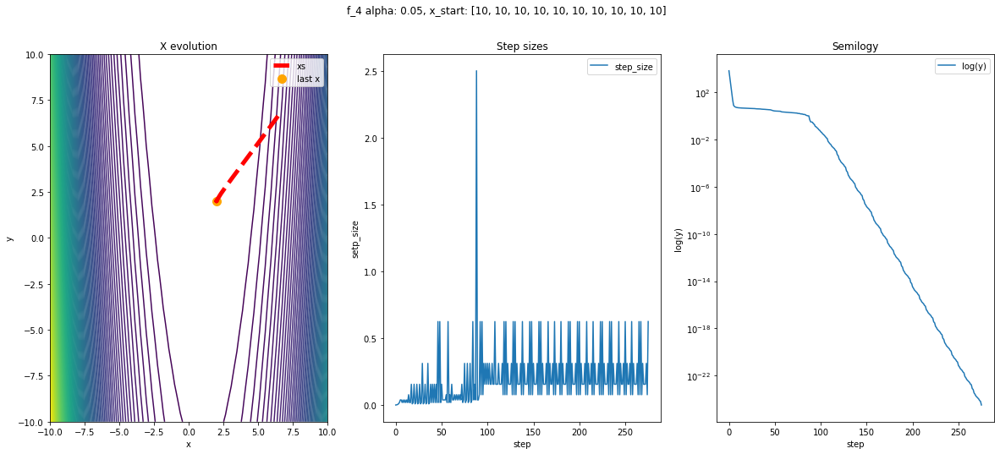

f_4 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


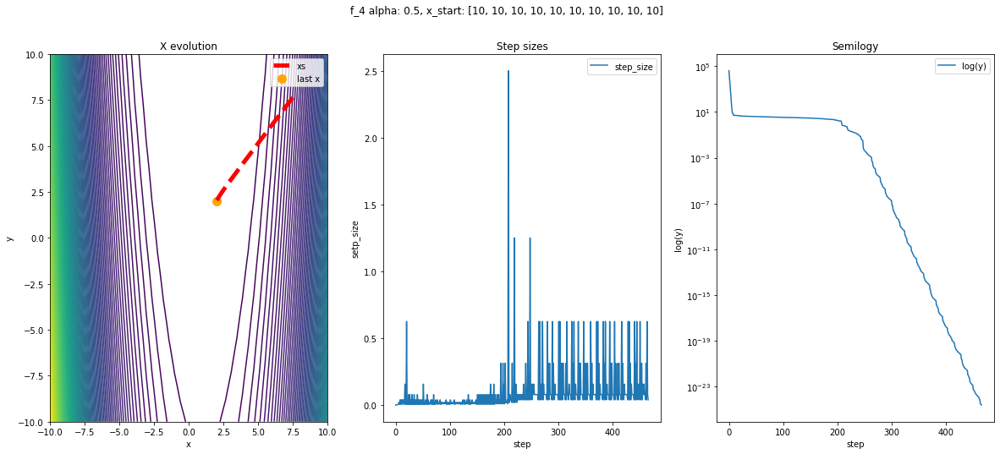

f_4 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


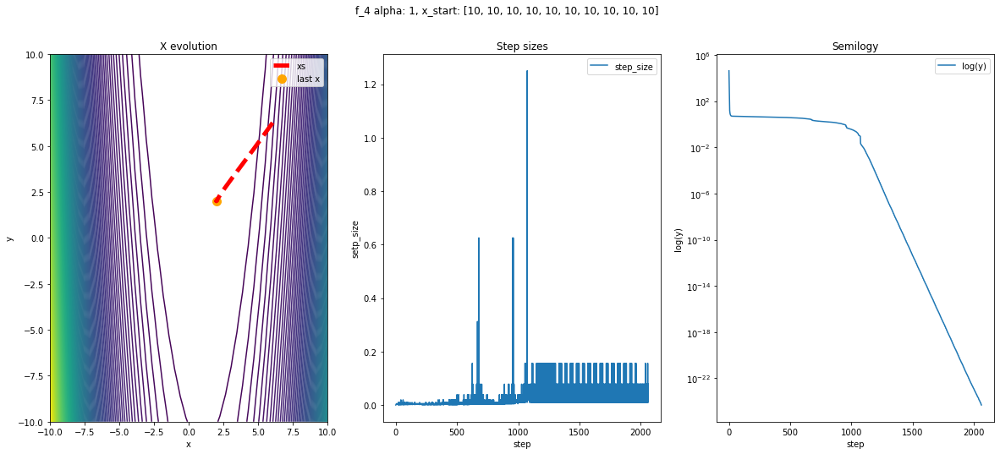

f_4 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


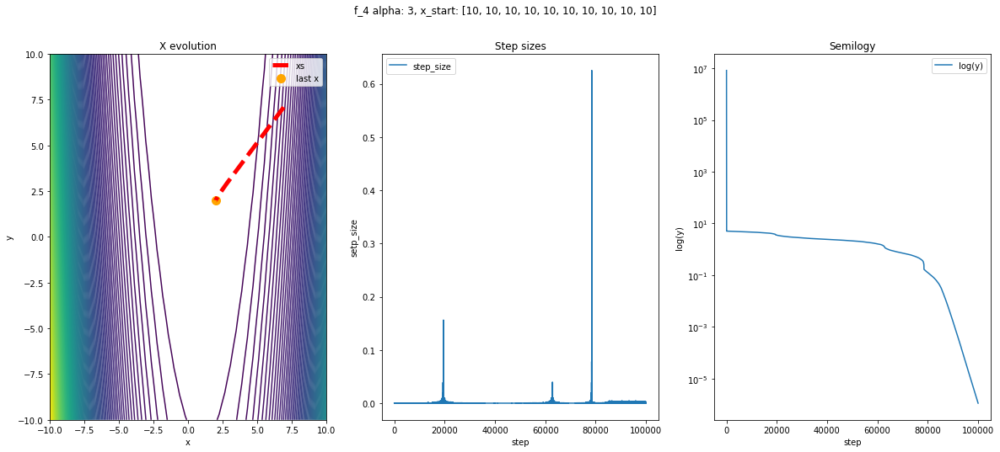

In [11]:
dir_path = './imgs/adaptatif_sz/'

alpha = [1/200, 1/20, .5, 1, 3]
X_start = [
    [10]*10
]

functions = [f_1, f_2, f_3, f_4]
functions_prime = [f_1_prime, f_2_prime, f_3_prime, f_4_prime]

for f, f_prime in zip(functions, functions_prime):
    for a in alpha:
        
        fig, axs = plt.subplots(1, 3, figsize=(20,8))
        fig.suptitle(f.__name__ + ' alpha: ' + str(a) + ', x_start: ' + str(x_i))
        
        X, Y, Z = evaluate(f, a)
        axs[0].contour(X, Y, Z, 120)
        
        for x_i in X_start:
            print(f.__name__, ': alpha: ', a, ', x_i: ', x_i)

            xs, ys, szs = gd_adaptatif_sz(np.array(x_i), f, f_prime , a)
                
            axs[0].set_title('X evolution')
            axs[0].set_xlabel('x')
            axs[0].set_ylabel('y')
            axs[0].plot(xs[:,0], xs[:,1], '--', lw=5, label='xs', c='r')
            axs[0].scatter(xs[-1][0], xs[-1][1], c='orange', s=100, label='last x')
            axs[0].legend()
                
            axs[1].set_title('Step sizes')
            axs[1].set_xlabel('step')
            axs[1].set_ylabel('setp_size')
            axs[1].plot(szs, label="step_size")
            axs[1].legend()
                
            axs[2].set_title('Semilogy')
            axs[2].set_xlabel('step')
            axs[2].set_ylabel('log(y)')
            axs[2].semilogy(ys, label='log(y)')
            axs[2].legend()
                
        name = f.__name__ + '_a-' + str(a) + '_adaptatif' + ".png"
        name = dir_path + name
        plt.savefig(name)
        plt.show()

# 3. Newton

In [49]:
def f_1_second(X, alpha=1):
    return 2 * alpha * np.ones(len(X))

def f_2_second(X, alpha=1):
    n = len(X)
    s = []
    for i in range(1, n+1):
        s += [(10**(alpha*(i-1)/(n-1)))]
    return s
            
def f_3_second(X, alpha=1):
    X = np.array(X, dtype=np.float64)

    n = len(X)
    s = []
    i = 0
    for x in X:
        i += 1
        s += [(10**(alpha*(i-1)/(n-1))*2 + 10*4*(np.pi**2)*np.cos(2*np.pi*(x-1)))]
    return s

def f_3_second_V2(X, a=1):
    x = np.array(X)
    n = len(x)
    x_res = []
    for i in range(1,n+1):
        x_res.append(2*10**(a*(i-1)/(n-1))*(x[i-1]-1) + 2*10*np.pi*np.sin(2*np.pi*(x[i-1]-1)))
    return np.array(x_res)

def f_4_second(X, alpha=1):
    X = np.array(X, dtype=np.float64)
    
    n = len(x)
    s = [ 4* 10**alpha * (3*(x[1-1] - 1)**2 - (x[1] - 1))+2]
    for i in range(2,n):
        s += [4*10**alpha*(3*(x[i-1] - 1)**2 - (x[i] - 1)) + 2 + 2*10**alpha]
    s += [2*10**alpha]
    return s

def f_4_second_V2(X, alpha=1):
    x = np.array(X)
    n = len(x)
    X_res = [4*10**a*(3*(x[1-1] - 1)**2 - (x[1] - 1))+2]
    for i in range(2,n):
        X_res.append(4*10**a*(3*(x[i-1] - 1)**2 - (x[i] - 1)) + 2 + 2*10**a)
    X_res.append(2*10**a)
    return X_res

In [13]:
def algo_newton(x0 ,f, grad, grad2, alpha, n_iter=10**5, approx=10**(-12)):
    X = x0
    Xs = [X]
    fXs =[f(X, alpha)]
    xt = x0
    gXs = [np.linalg.norm(grad(xt, alpha))]
    x_aux = x0+153
    t=0
    while (t < n_iter) and np.linalg.norm(grad(xt, alpha)) >= approx:
        dt = -grad(xt, alpha)/grad2(xt, alpha)
        x_aux = xt
        xt = xt + dt
        if f(xt, alpha)< f(X, alpha):
            X = xt
        t+=1
        Xs = np.vstack((Xs, X))
        fXs = np.vstack((fXs, f(X, alpha)))
        gXs = np.vstack((gXs, [np.linalg.norm(grad(xt, alpha))]))
    return X, Xs, fXs, gXs

f_1 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


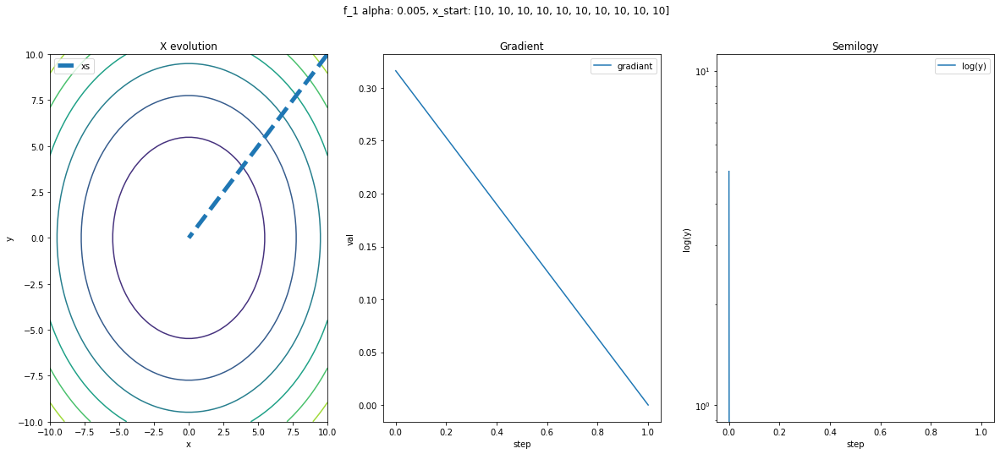

f_1 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


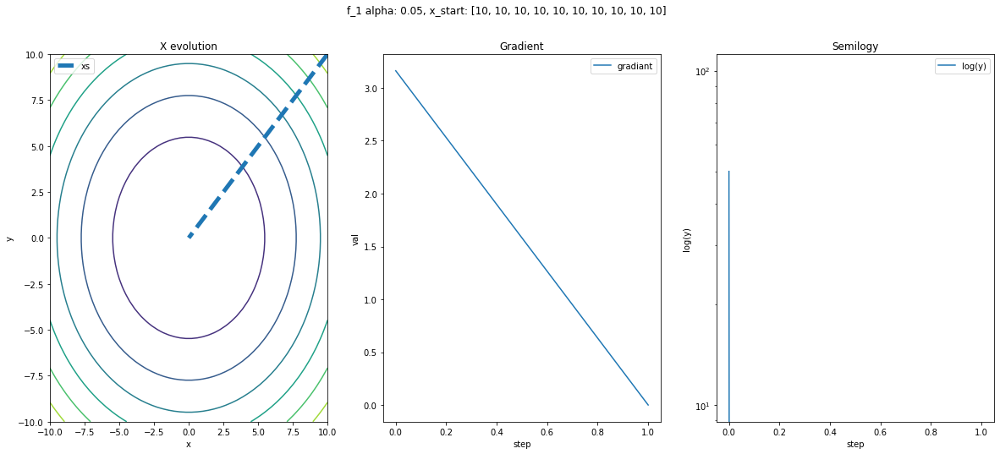

f_1 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


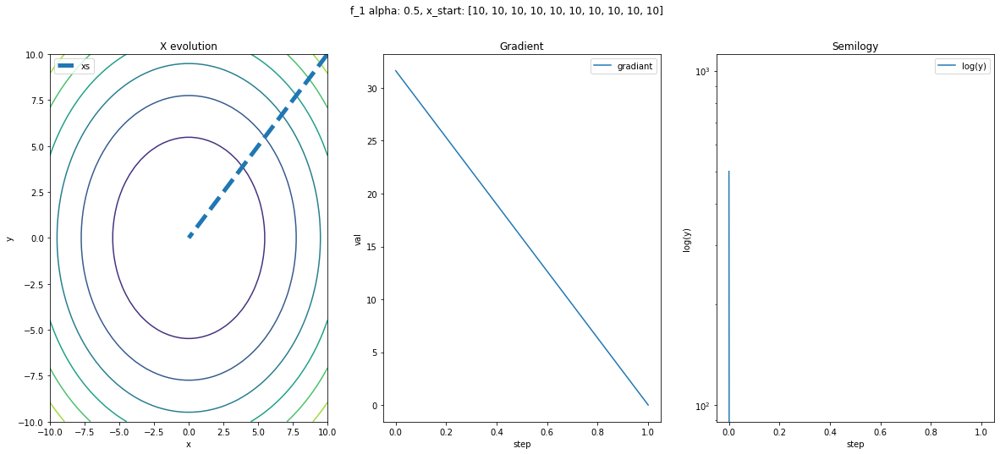

f_1 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


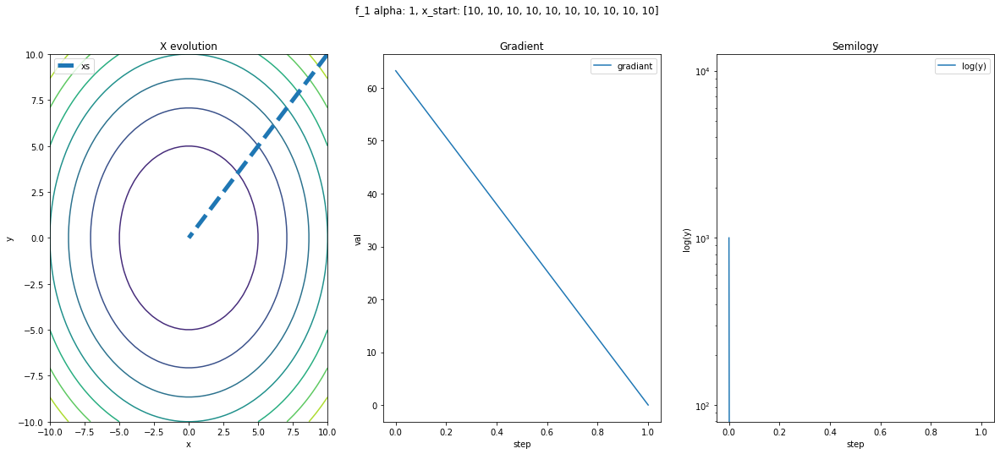

f_1 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


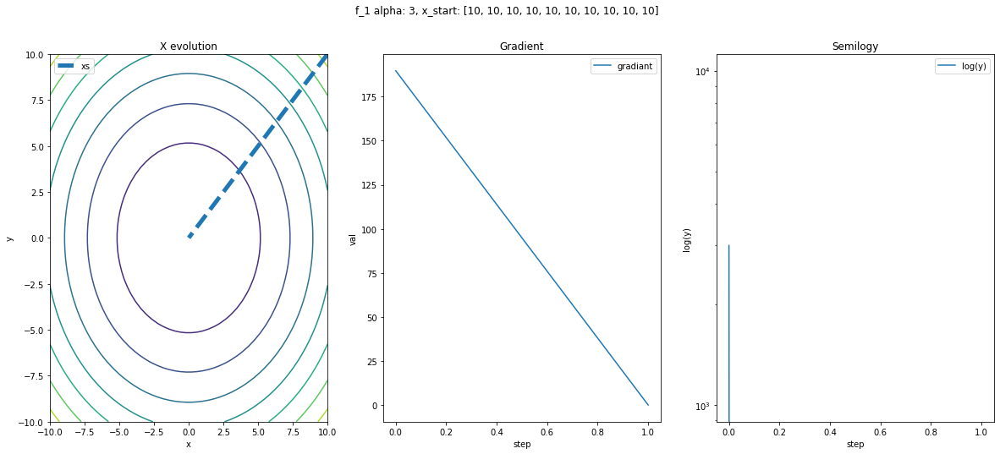

f_2 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


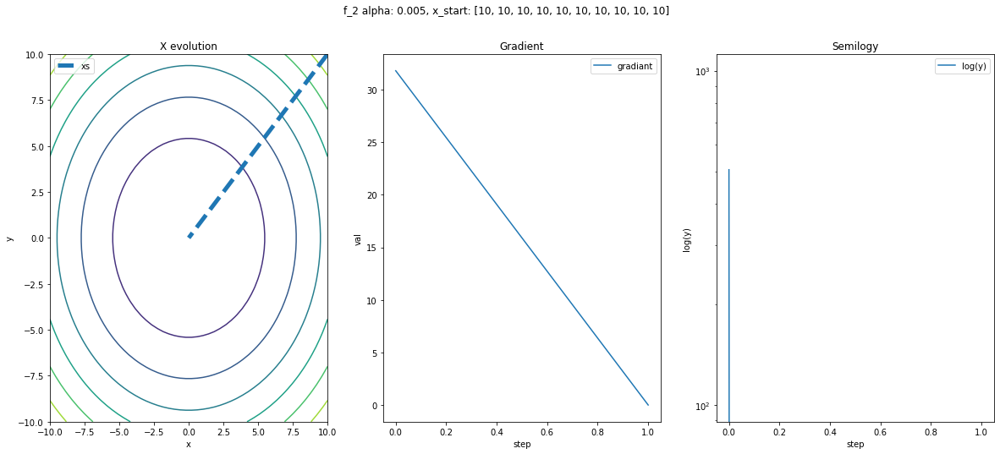

f_2 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


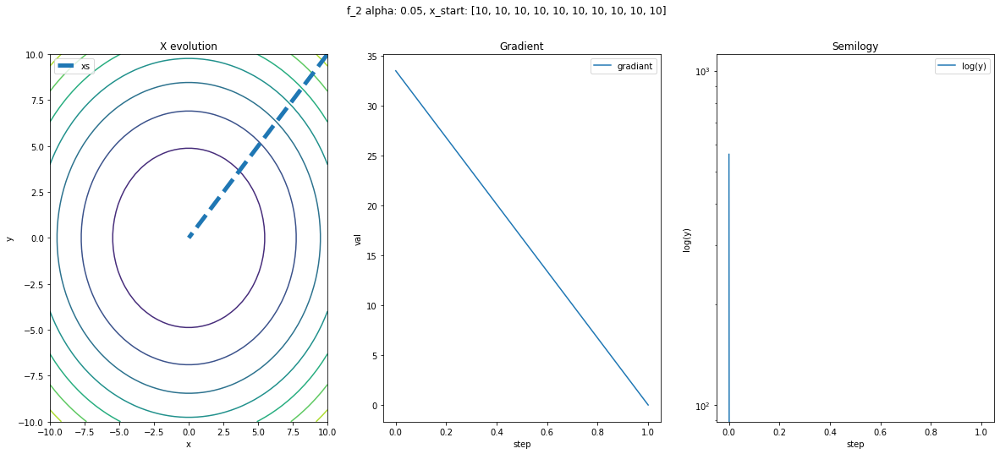

f_2 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


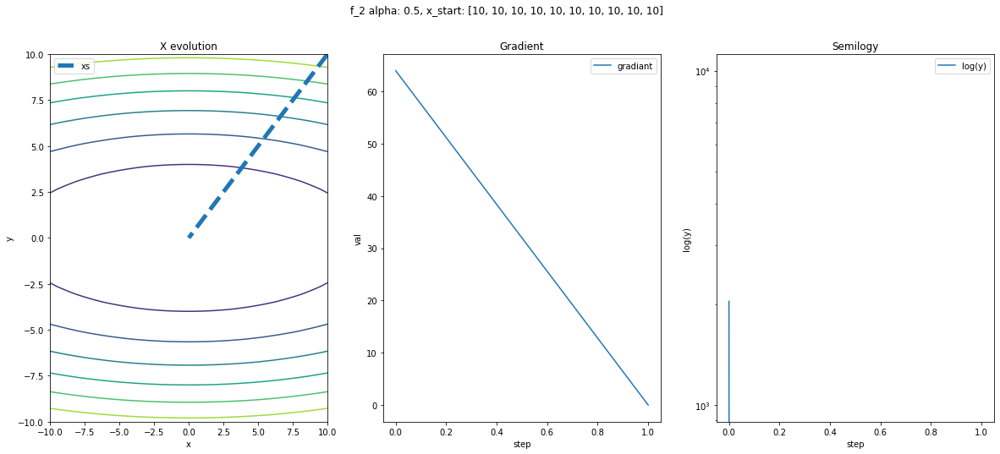

f_2 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


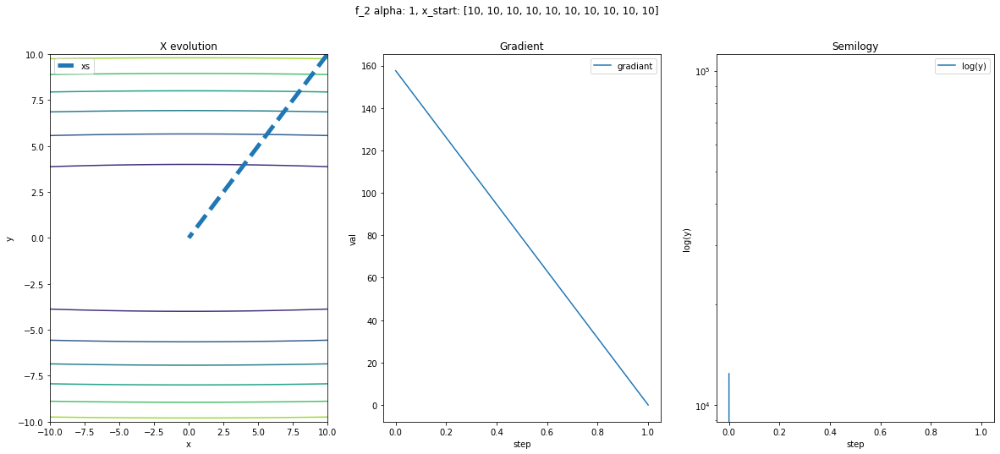

f_2 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


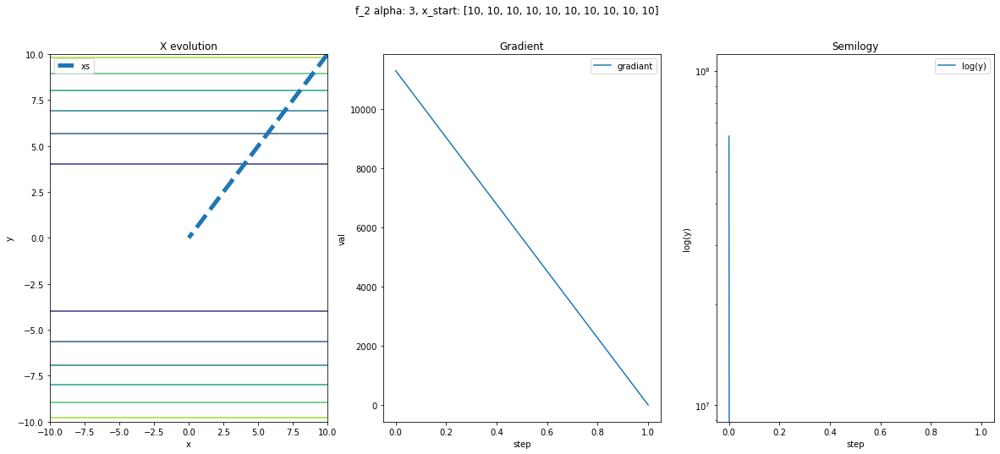

f_3 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


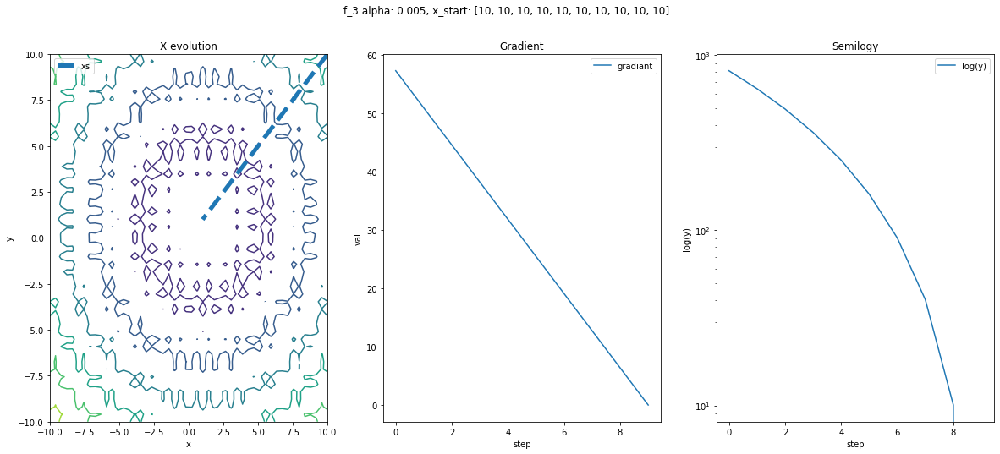

f_3 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


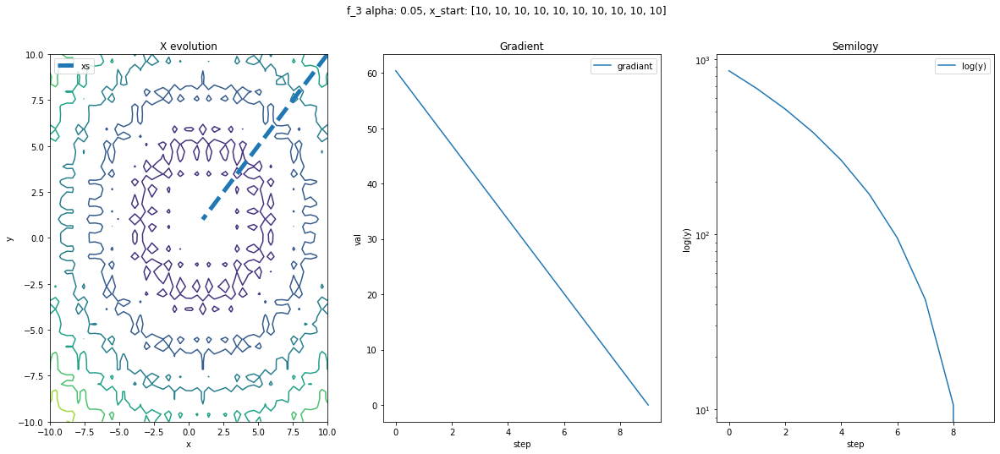

f_3 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


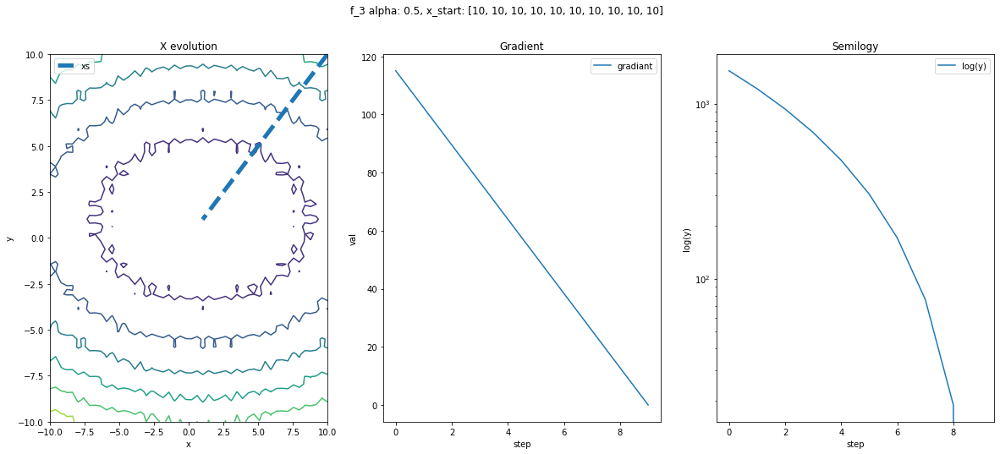

f_3 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


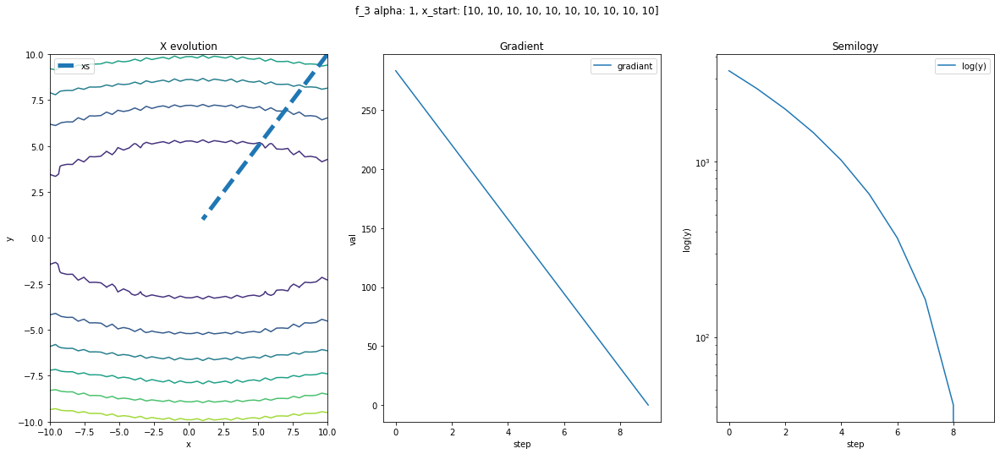

f_3 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


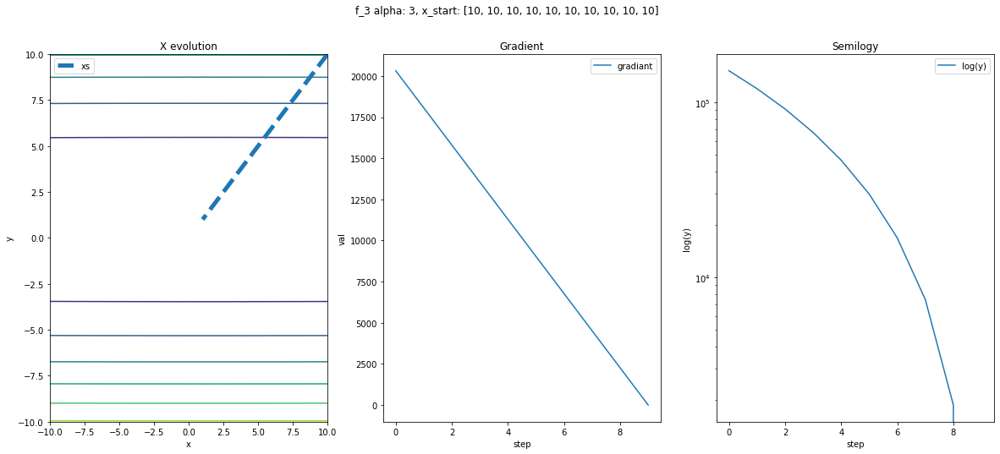

f_4 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


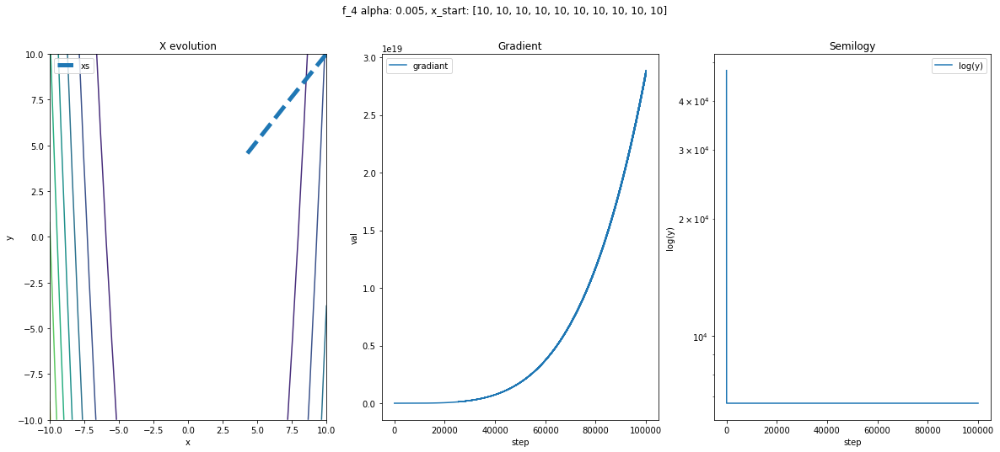

f_4 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


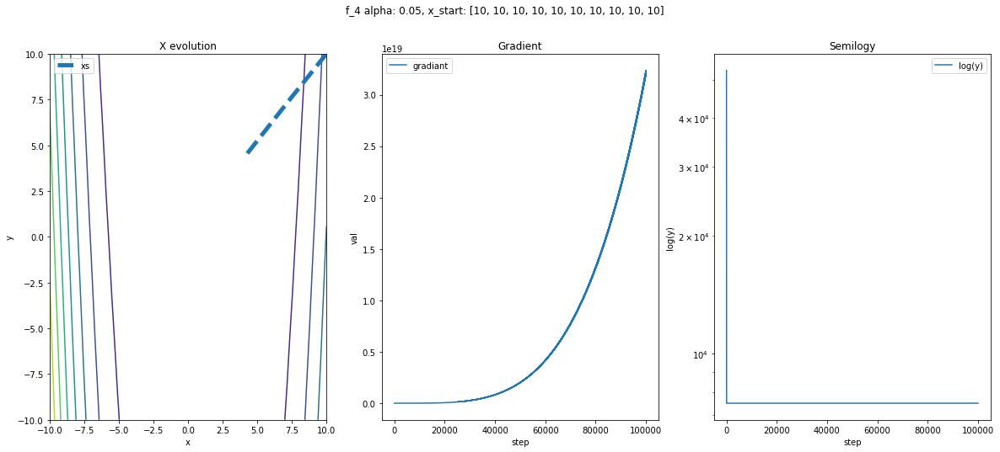

f_4 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


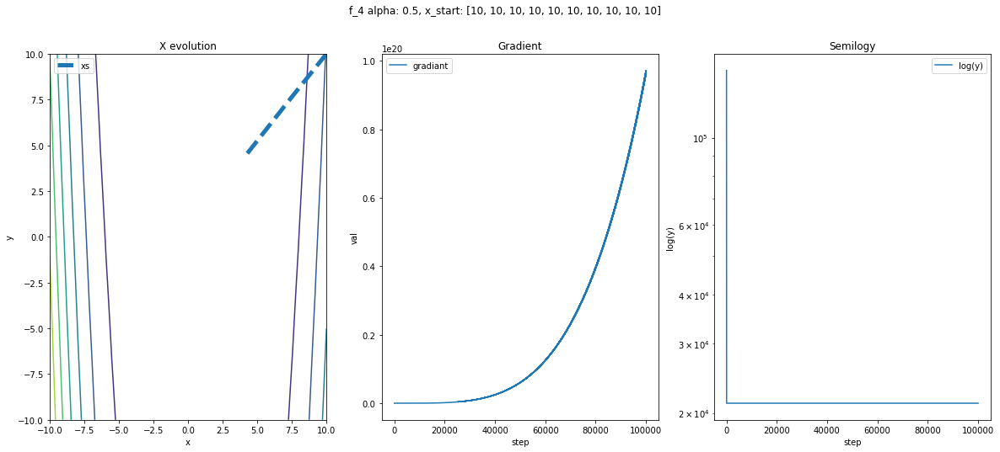

f_4 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


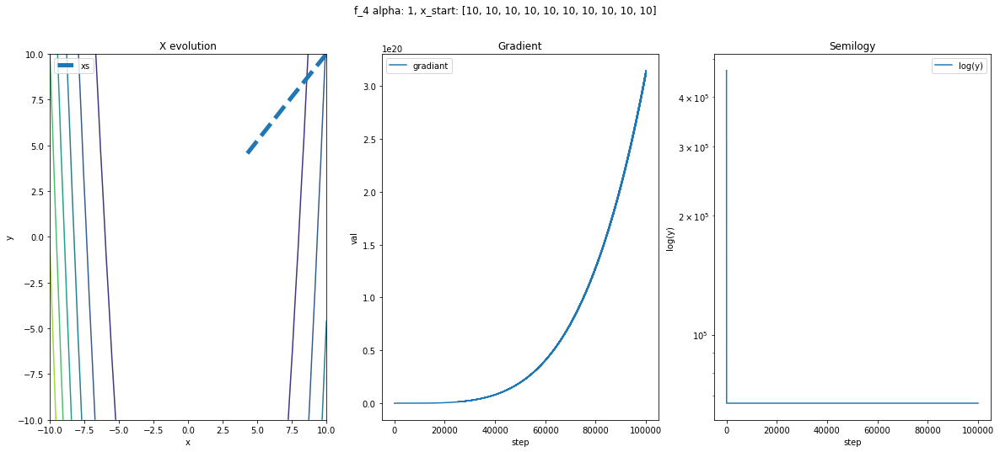

f_4 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


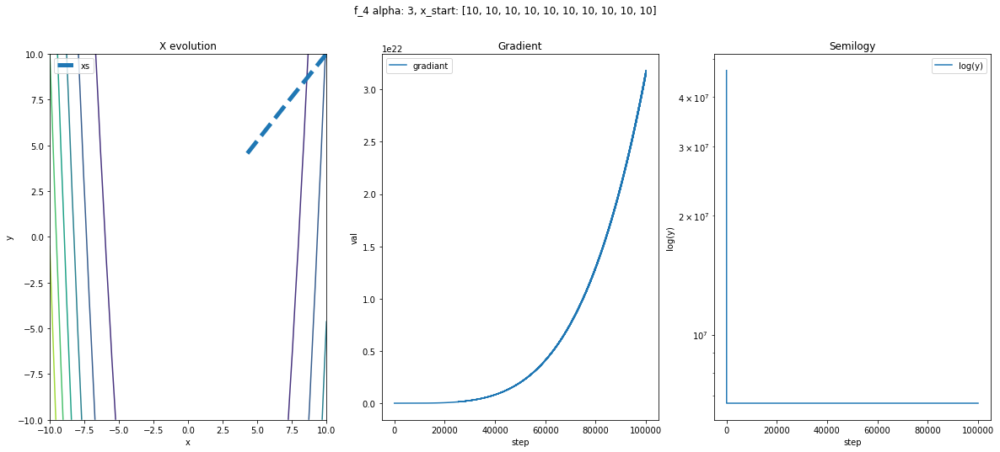

In [43]:
dir_path = './imgs/newton/'

alpha = [1/200, 1/20, .5, 1, 3]
X_start = [
    [10]*10
]

functions = [f_1, f_2, f_3, f_4]
functions_prime = [f_1_prime, f_2_prime, f_3_prime, f_4_prime_V2]
functions_second = [f_1_second, f_2_second, f_3_second_V2, f_4_second_V2]

for f, f_prime, f_second in zip(functions, functions_prime, functions_second):
    for a in alpha:
        
        fig, axs = plt.subplots(1, 3, figsize=(20,8))
        fig.suptitle(f.__name__ + ' alpha: ' + str(a) + ', x_start: ' + str(x_i))
        
        X, Y, Z = evaluate(f, a)
        axs[0].contour(X, Y, Z)
        
        for x_i in X_start:
            print(f.__name__, ': alpha: ', a, ', x_i: ', x_i)

            _, xs, ys, gs = algo_newton(np.array(x_i), f, f_prime, f_second, a)
                
            axs[0].set_title('X evolution')
            axs[0].set_xlabel('x')
            axs[0].set_ylabel('y')
            axs[0].plot(xs[:,0], xs[:,1], '--', lw=5, label='xs')
            axs[0].legend()
                
            axs[1].set_title('Gradient')
            axs[1].set_xlabel('step')
            axs[1].set_ylabel('val')
            axs[1].plot(gs, label="gradiant")
            axs[1].legend()
                
            axs[2].set_title('Semilogy')
            axs[2].set_xlabel('step')
            axs[2].set_ylabel('log(y)')
            axs[2].semilogy(ys, label='log(y)')
            axs[2].legend()
                
        name = f.__name__ + '_a-' + str(a) + '_newton' + ".png"
        name = dir_path + name
        plt.savefig(name)
        plt.show()

# Scipy Optimize

In [45]:
from scipy.optimize import line_search, fmin_l_bfgs_b

f_1 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


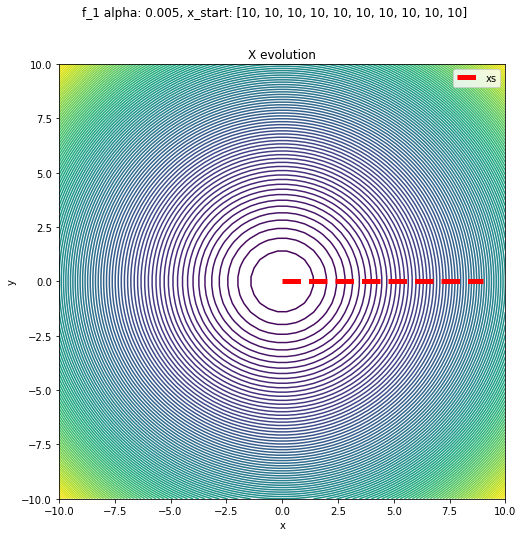

f_1 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


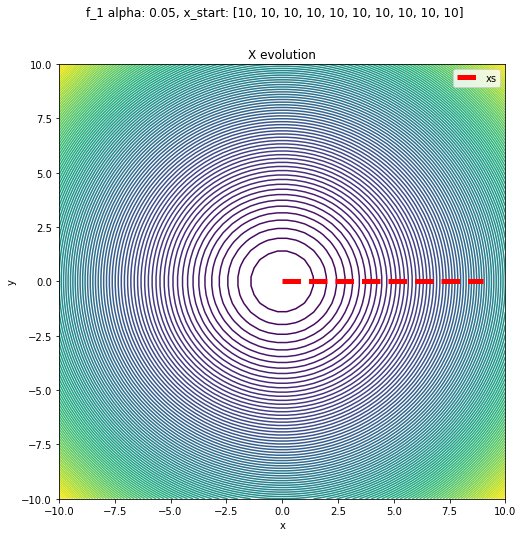

f_1 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


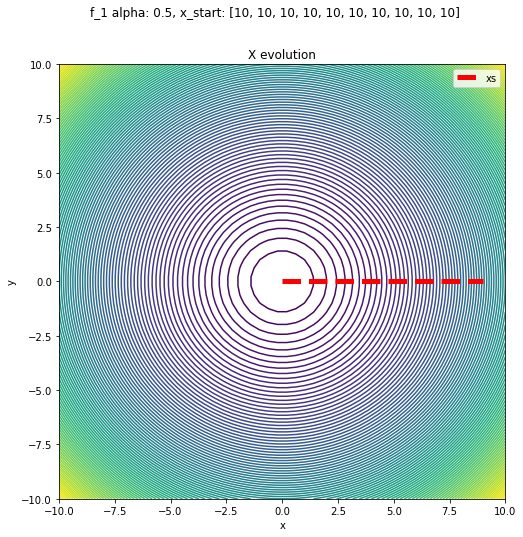

f_1 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


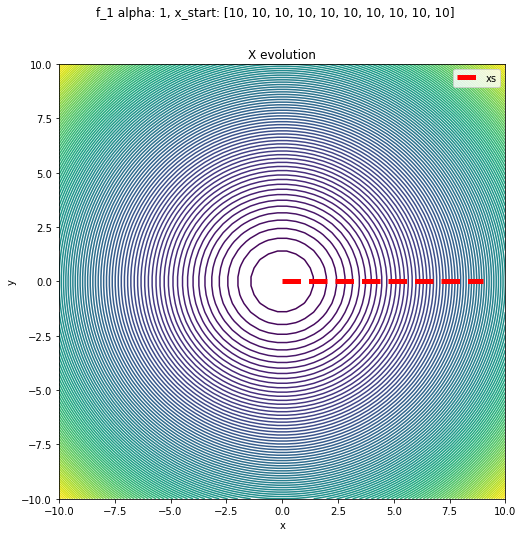

f_1 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


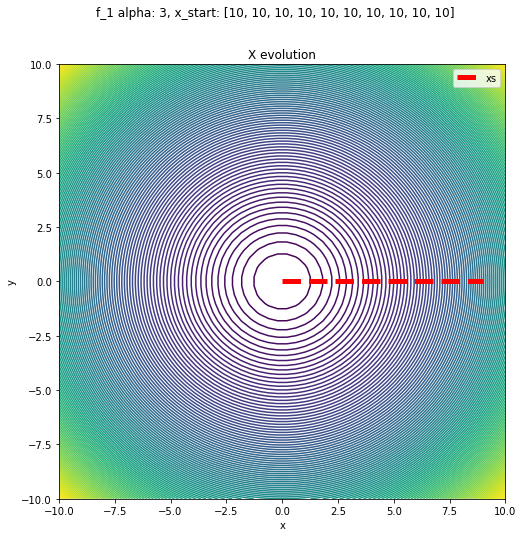

f_2 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


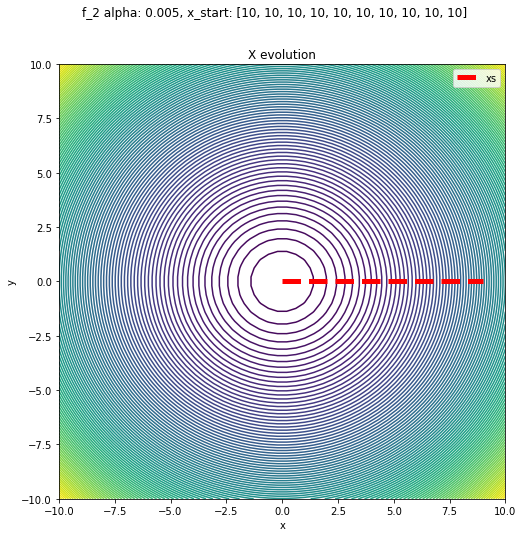

f_2 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


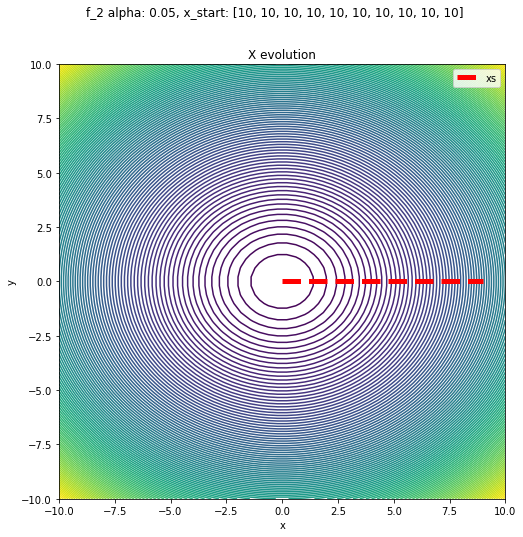

f_2 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


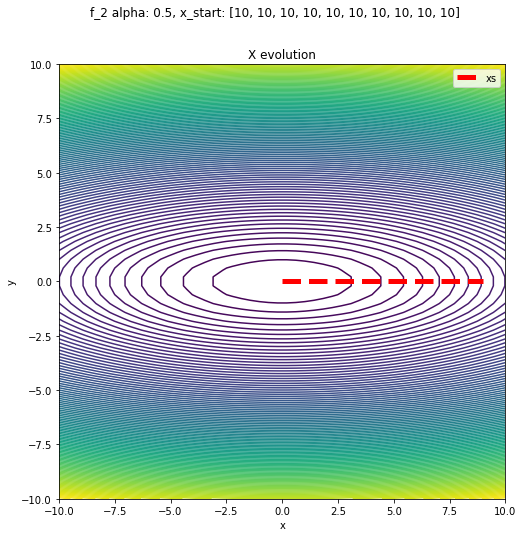

f_2 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


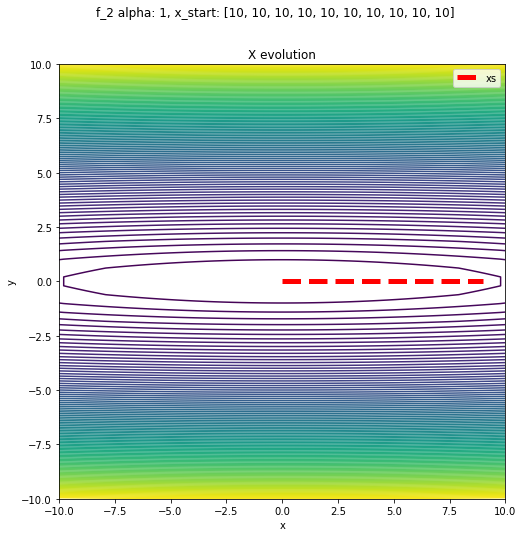

f_2 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


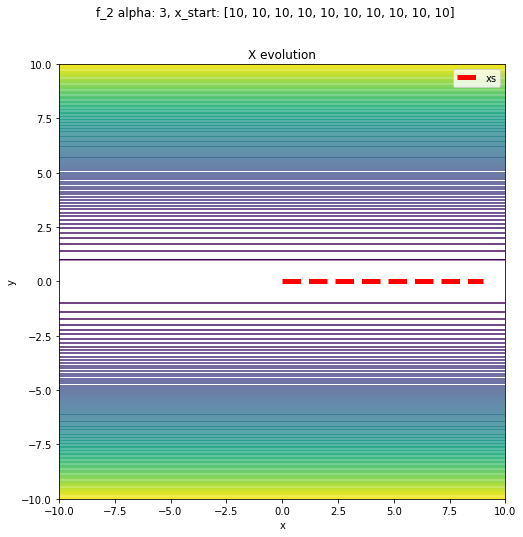

f_3 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


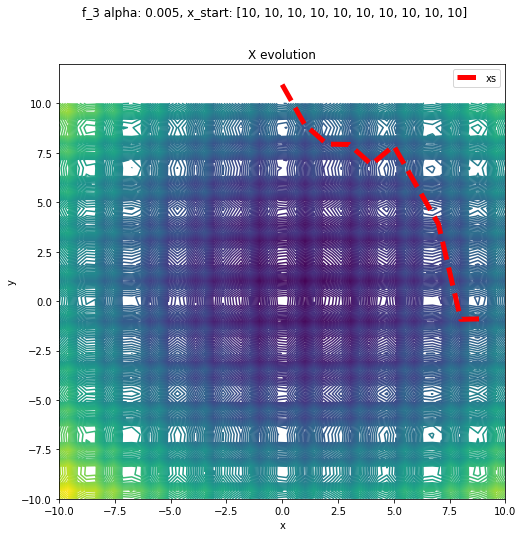

f_3 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


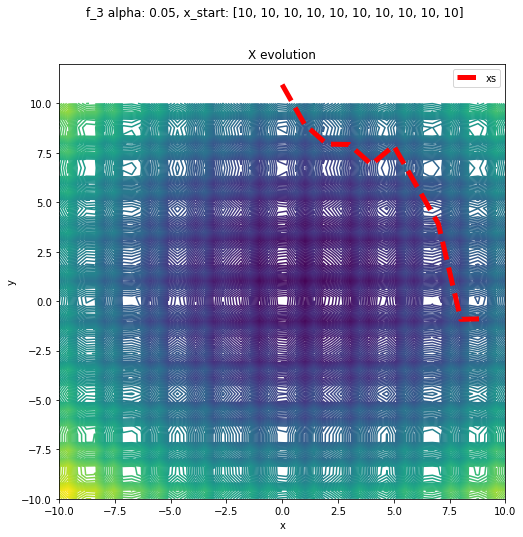

f_3 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


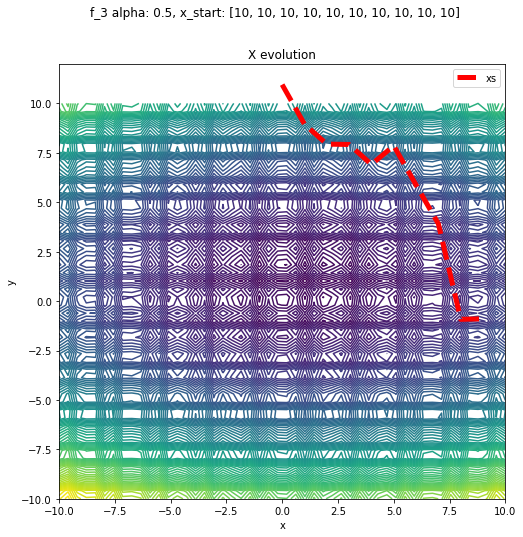

f_3 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


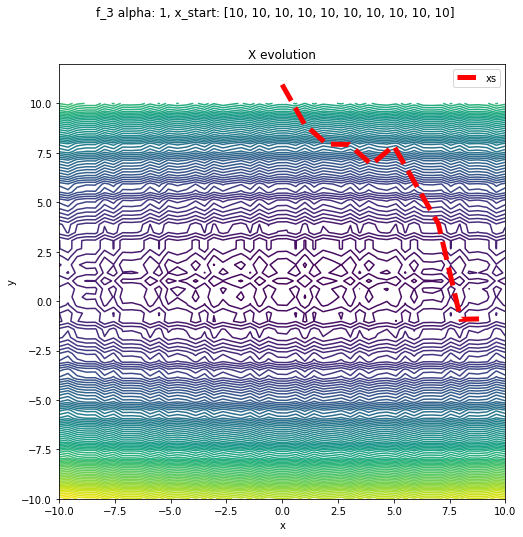

f_3 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


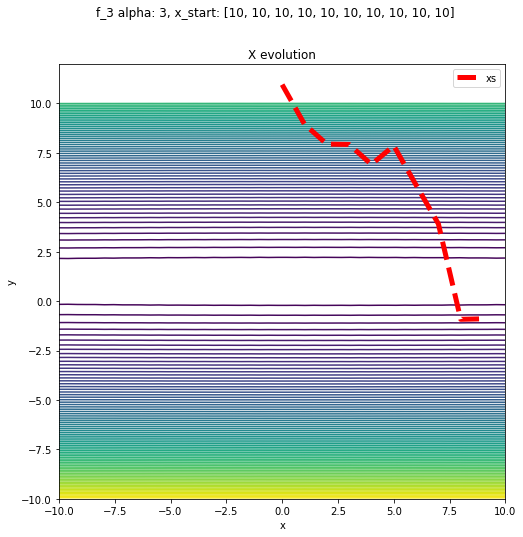

f_4 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


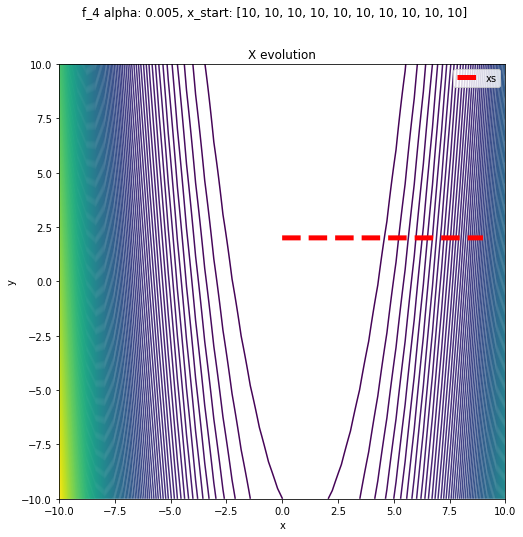

f_4 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


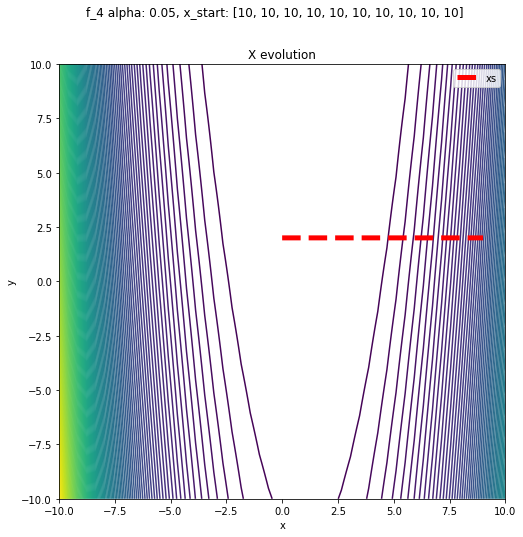

f_4 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


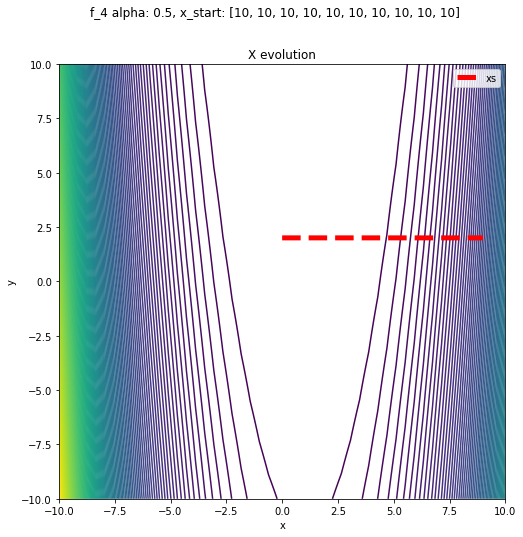

f_4 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


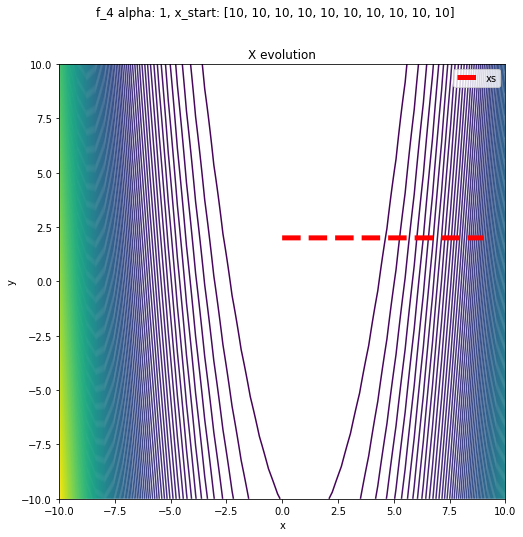

f_4 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


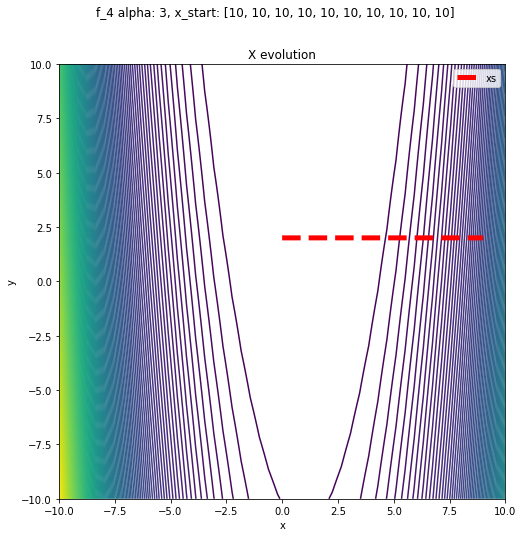

In [84]:
dir_path = './imgs/scipy/'

alpha = [1/200, 1/20, .5, 1, 3]
X_start = [
    [10]*10
]

functions = [f_1, f_2, f_3, f_4]
functions_prime = [f_1_prime, f_2_prime, f_3_prime, f_4_prime]

for f, f_prime in zip(functions, functions_prime):
    for a in alpha:
        
        fig, axs = plt.subplots(1, 1, figsize=(8,8))
        fig.suptitle(f.__name__ + ' alpha: ' + str(a) + ', x_start: ' + str(x_i))
        
        X, Y, Z = evaluate(f, a)
        axs.contour(X, Y, Z, 120)
        
        for x_i in X_start:
            print(f.__name__, ': alpha: ', a, ', x_i: ', x_i)

            X_bfgs, f_min, dic = fmin_l_bfgs_b(f, np.array(x_i), fprime=f_prime)
                            
            axs.set_title('X evolution')
            axs.set_xlabel('x')
            axs.set_ylabel('y')
            axs.plot(X_bfgs, '--', lw=5, label='xs', c='r')
            axs.legend()
                
                
        name = f.__name__ + '_a-' + str(a) + '_bfgs' + ".png"
        name = dir_path + name
        plt.savefig(name)
        plt.show()

# Algorithme : ($\mu /\mu$, $\lambda$)-ES

In [66]:
def algo4(f, mu, lmbda, sigma0, x0, n_iter=2*10**4):
    assert(len(mu)<=lmbda)
    n = len(x0)
    sigma = sigma0
    X = x0
    Xs = np.array([f(X)])
    for i in range(n_iter):
        x = sigma*np.random.normal(0, 1, size=(lmbda,n))
        x = x + X
        x = x.tolist()
        x.sort(key=f)
        x = np.array(x)
        m = np.sum(mu.reshape(len(mu),1)*x[:len(mu)],axis=0)
        if f(m) > f(X):
            sigma = 0.8*sigma
        else:
            sigma = 1.1*sigma
        X = m
        Xs = np.vstack((Xs, f(X)))
    return X, Xs

def escma(f, mu, lambd, start, sig, t_max):
    x = start
    t = 0
    
    xs = []
    ys = []
    sigs = [sig]
    
    while t < t_max:
        t += 1
        x = x + sig * np.random.normal(0, 1, size=(lambd,len(start)))
        
        # calc
        tmp_y = np.array([])
        for x_i in x:
            tmp_y = np.append(tmp_y, f(x_i))
        
        # reorder
        ind = np.argsort(tmp_y)
        tmp_y_order = tmp_y[ind][:mu]
        
        w = tmp_y_order / tmp_y[ind][:mu].sum()
        
        x *= w
        xs += [x]
        ys += [tmp_y]
        
        #print('w : ', w)
        #print('tmp_y_order : ', tmp_y_order)
        #break
            
    return xs, ys, sigs

In [73]:
lmbda = 20
sigma0 = 0.001
mu = np.array([0.3,0.25,0.2,0.15,0.1])
x0 = np.array([1,1,1,1,1])

for i in range(5):
    X_f1, Xs_f1 = algo4(f_1, mu, lmbda, sigma0, x0)
    plt.semilogy(Xs_f1)
plt.show()

TypeError: unsupported operand type(s) for ** or pow(): 'list' and 'int'

# Comparaison

f_1 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


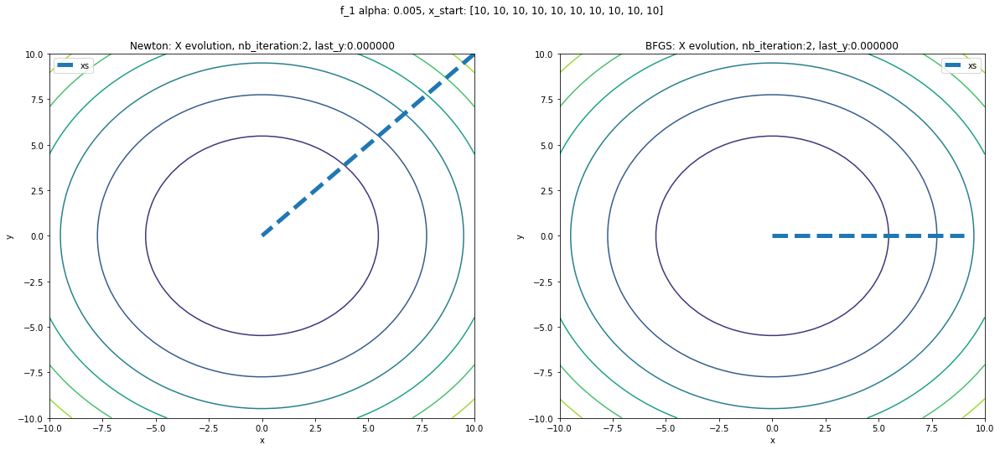

f_1 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


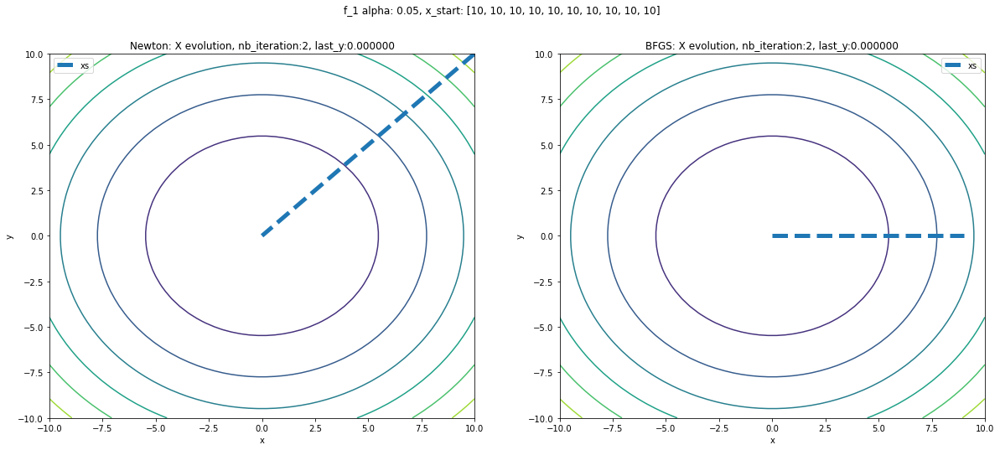

f_1 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


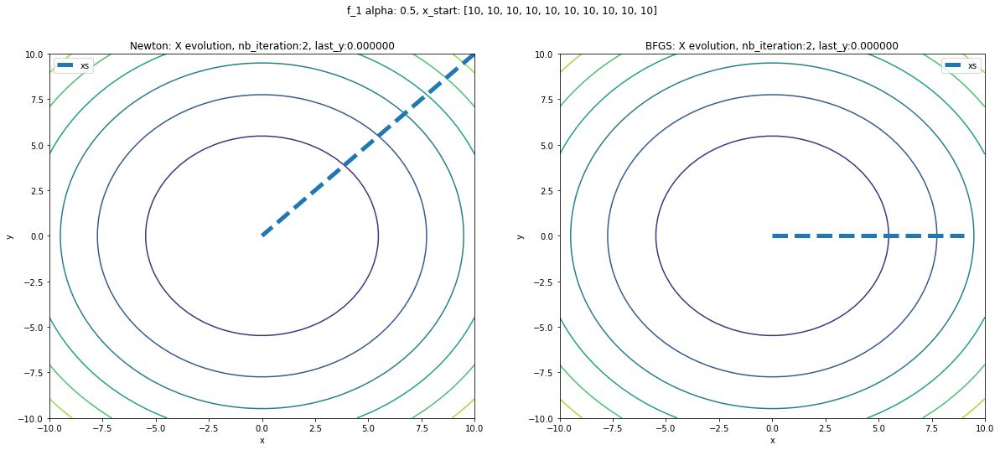

f_1 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


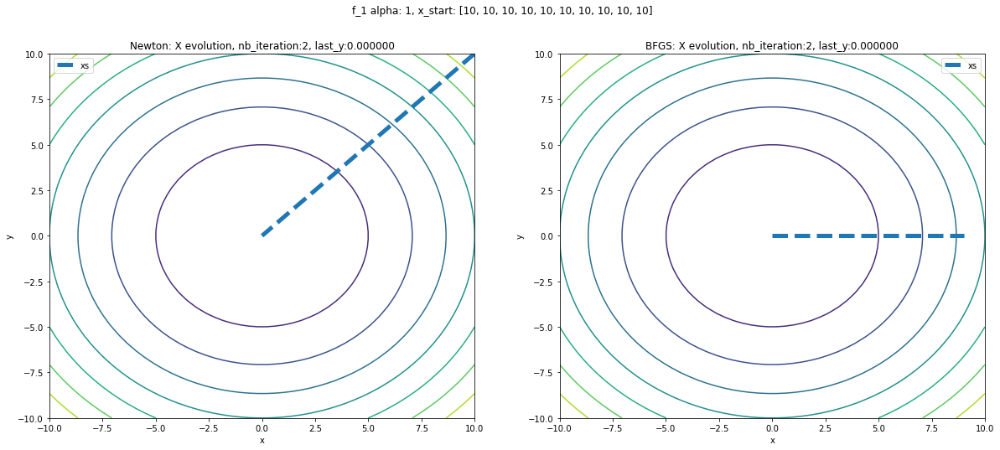

f_1 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


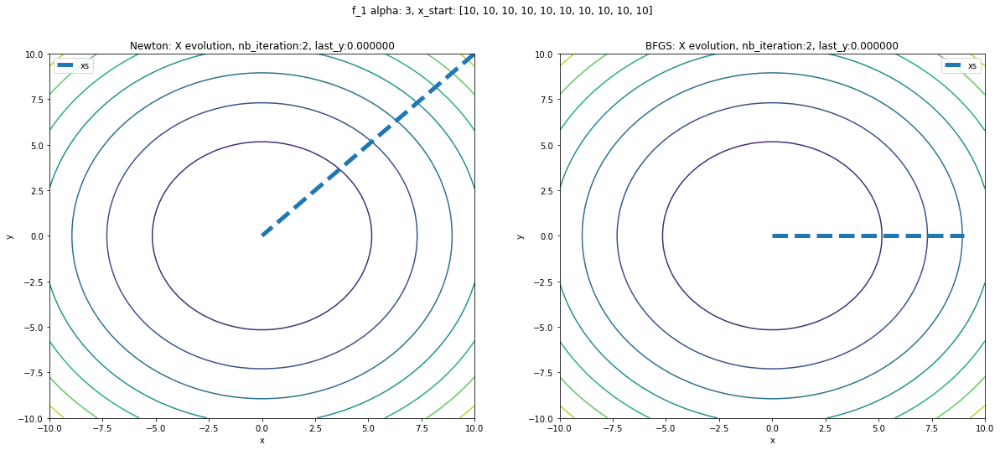

f_2 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


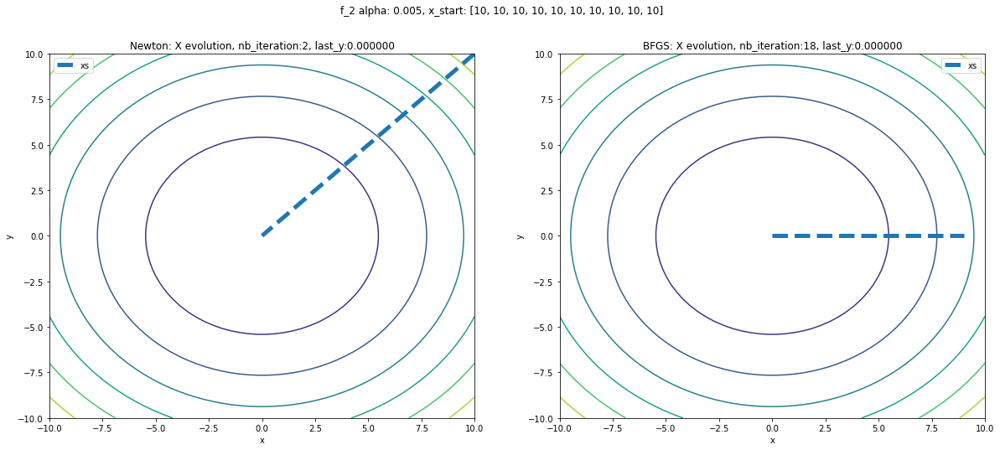

f_2 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


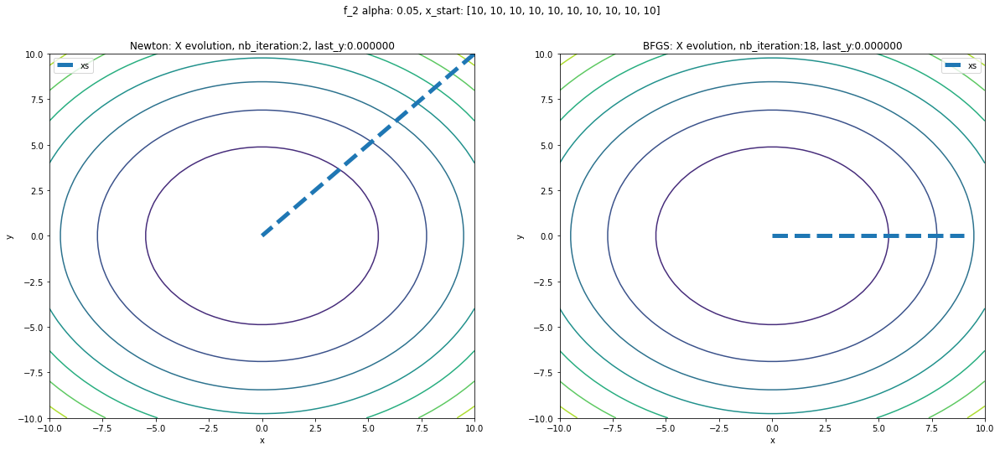

f_2 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


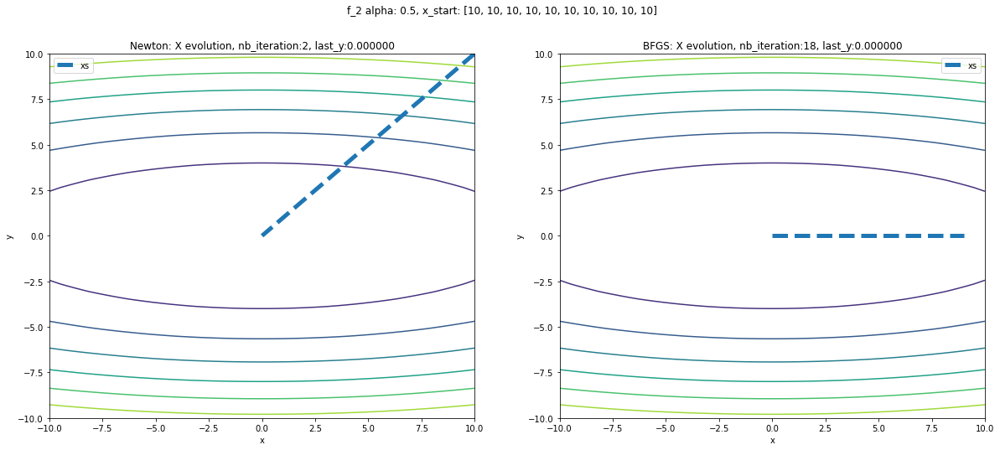

f_2 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


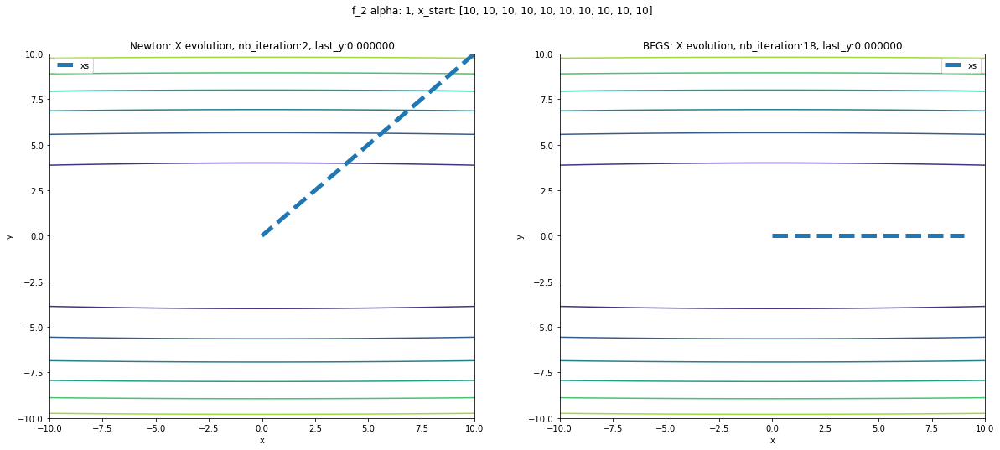

f_2 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


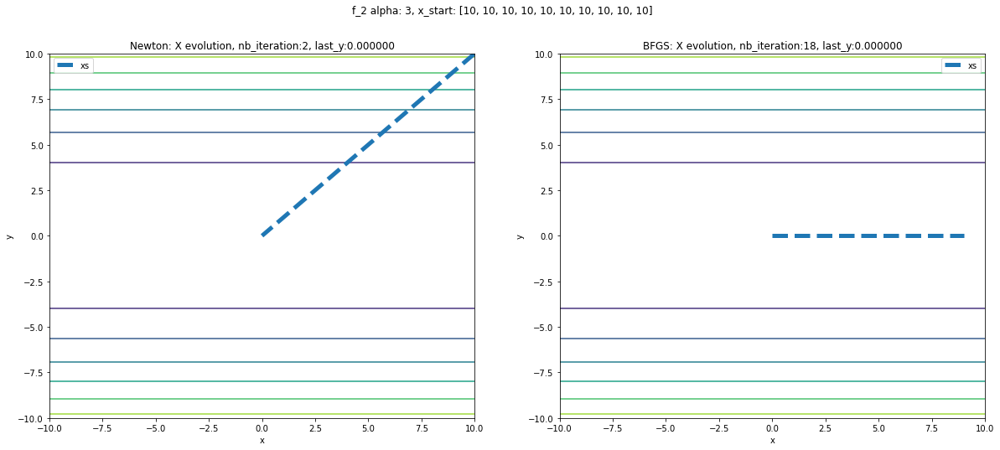

f_3 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


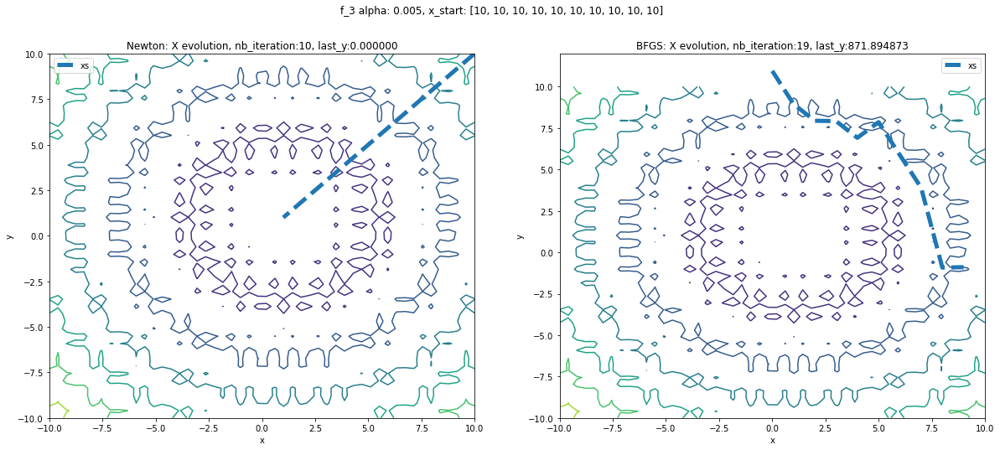

f_3 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


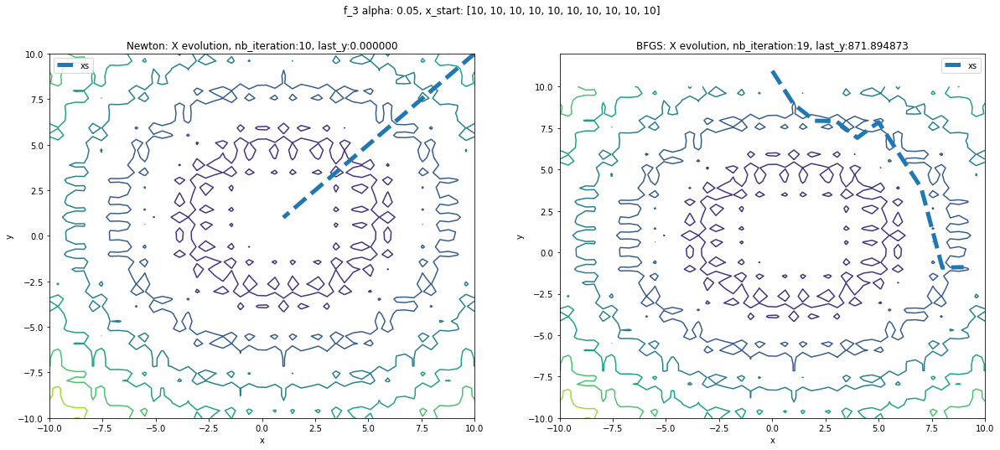

f_3 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


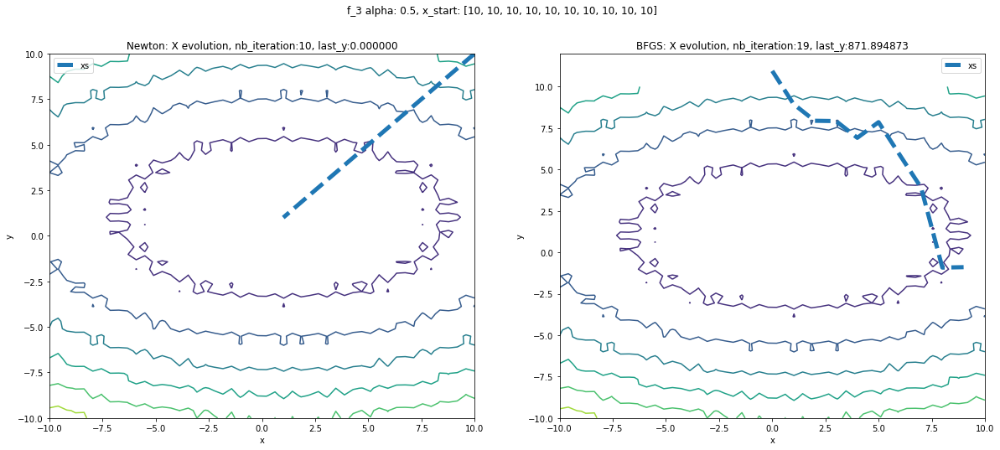

f_3 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


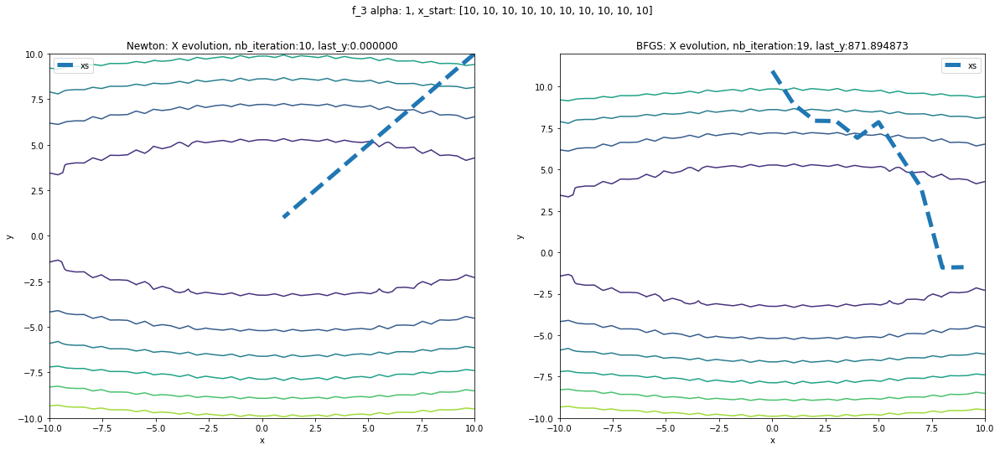

f_3 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


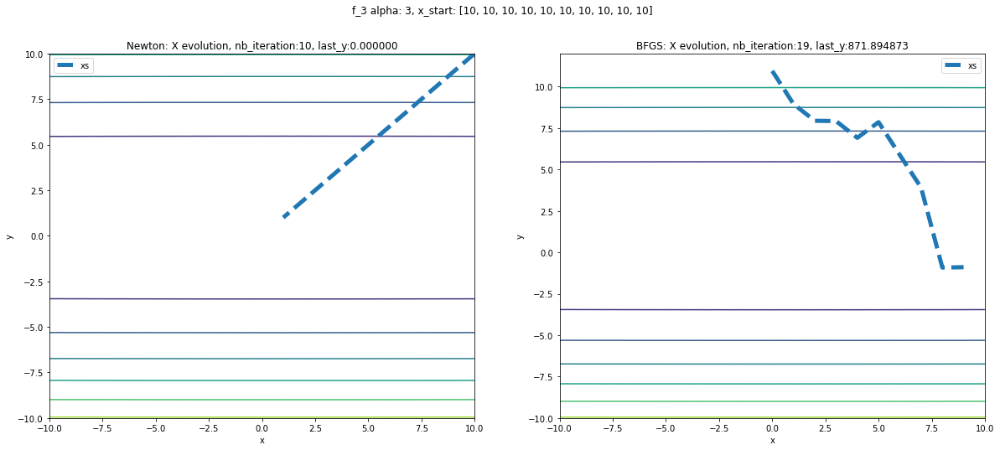

f_4 : alpha:  0.005 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


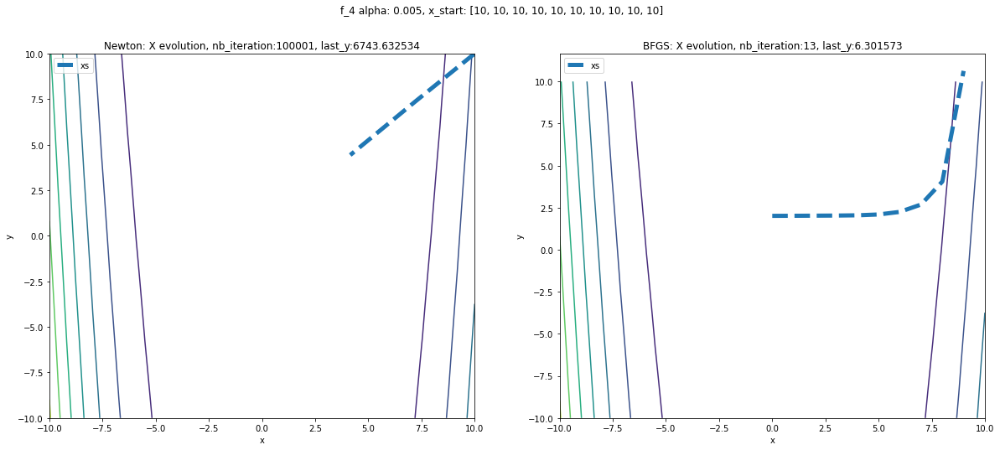

f_4 : alpha:  0.05 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


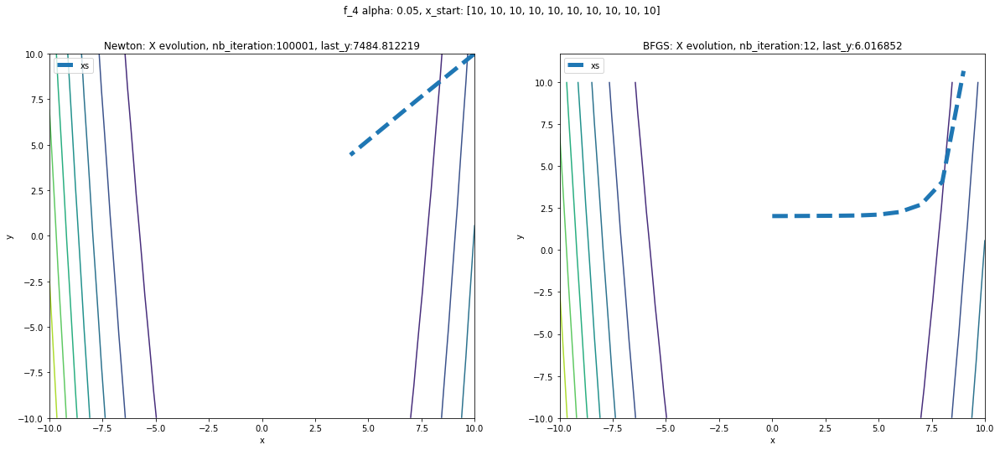

f_4 : alpha:  0.5 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


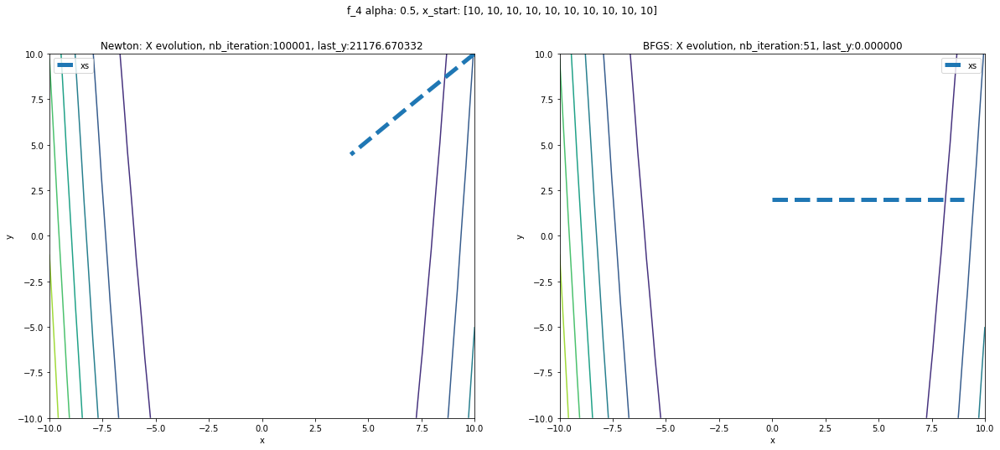

f_4 : alpha:  1 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


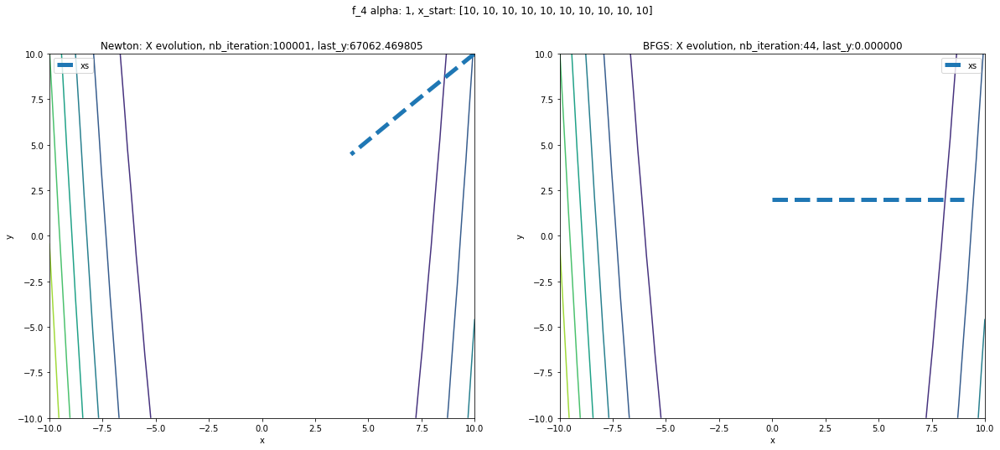

f_4 : alpha:  3 , x_i:  [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]


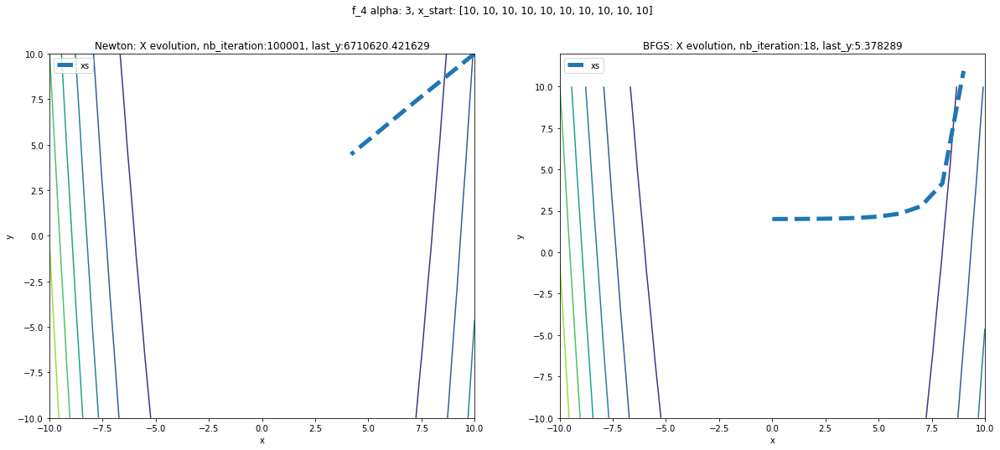

In [100]:
dir_path = './imgs/comparaison/'

alpha = [1/200, 1/20, .5, 1, 3]
X_start = [
    [10]*10
]

functions = [f_1, f_2, f_3, f_4]
functions_prime = [f_1_prime, f_2_prime, f_3_prime, f_4_prime_V2]
functions_second = [f_1_second, f_2_second, f_3_second_V2, f_4_second_V2]

for f, f_prime, f_second in zip(functions, functions_prime, functions_second):
    for a in alpha:
        
        fig, axs = plt.subplots(1, 2, figsize=(20,8))
        fig.suptitle(f.__name__ + ' alpha: ' + str(a) + ', x_start: ' + str(x_i))
        
        X, Y, Z = evaluate(f, a)
        axs[0].contour(X, Y, Z)
        axs[1].contour(X, Y, Z)
        
        for x_i in X_start:
            print(f.__name__, ': alpha: ', a, ', x_i: ', x_i)

            _, xs, ys, gs = algo_newton(np.array(x_i), f, f_prime, f_second, a)
            X_bfgs, f_min, dic = fmin_l_bfgs_b(f, np.array(x_i), fprime=f_prime)
                
            axs[0].set_title('Newton: X evolution, nb_iteration:%d, last_y:%f' % (len(ys), ys[-1]))
            axs[0].set_xlabel('x')
            axs[0].set_ylabel('y')
            axs[0].plot(xs[:,0], xs[:,1], '--', lw=5, label='xs')
            axs[0].legend()
                
            axs[1].set_title('BFGS: X evolution, nb_iteration:%d, last_y:%f' % (dic['nit'], f_min))
            axs[1].set_xlabel('x')
            axs[1].set_ylabel('y')
            axs[1].plot(X_bfgs, '--', lw=5, label="xs")
            axs[1].legend()
                
                
        name = f.__name__ + '_a-' + str(a) + '.png'
        name = dir_path + name
        plt.savefig(name)
        plt.show()